# [# Chapter 3: Meeting your match](https://mbmlbook.com/TrueSkill.html)

Data: https://github.com/dotnet/mbmlbook/tree/145790dbf04498aa62143372d7f517358b86001a/src/3.%20Meeting%20Your%20Match/Data

In [1]:
import warnings
import sys

import arviz as az
import pandas as pd
import numpy as np

import pymc3 as pm
import theano.tensor as tt

import matplotlib.pyplot as plt
import seaborn as sns

%config Completer.use_jedi = False 

In [2]:
%config InlineBackend.figure_format = 'retina'
az.style.use("arviz-darkgrid")

print(f"Python version: {sys.version}")
print(f"Running on PyMC3 v{pm.__version__}")
print(f"Running on ArviZ v{az.__version__}")

Python version: 3.9.10 | packaged by conda-forge | (main, Feb  1 2022, 21:27:48) 
[Clang 11.1.0 ]
Running on PyMC3 v3.11.4
Running on ArviZ v0.11.4


## [ 2 Modelling the outcomes of the game](https://mbmlbook.com/TrueSkill_Modelling_the_outcome_of_games.html)

    "Our goal is to build a system which can assess the skills of players in online gaming. As a first step towards this, we need to look at the simpler problem of predicting the outcome of a game where we already know the skills of the players involved. This will allow us to develop many of the concepts required to solve the more complex problem of determining skills."
    
    
### Assumptions 
    
    1. Each player has a skill value, represented by a continuous variable.

     "We can capture this variability in the outcome of a game by introducing the notion of a performance for each player, which expresses how well they played on a particular game. The player with the higher performance for a specific game will be the winner of that game. A player with a high skill level will tend to have a high performance, but their actual performance will vary from one game to another."
     
     
     "We can think of a person’s skill as their average performance across many games. "
    

    2. Each player has a performance value for each game, which is independent from game to game and has an average value is equal to the skill of that player. The variation in performance, which is the same for all players, is symmetrically distributed around the mean value and is more likely to be close to the mean than to be far from the mean.
    
    3. The player with the highest performance value wins the game.

### Computing probability of winning knowing player's skill

In [3]:
with pm.Model() as model:
    JPerf = pm.Normal("JPerf", mu=15, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=12.5, sigma=5)
    Jwins = pm.Deterministic("Jwins", pm.math.switch(JPerf > FPerf, 1, 0))

In [4]:
# ancestral sampling
sim_prior = pm.sample_prior_predictive(samples=1000, model=model, random_seed=199)
sim_prior = pd.DataFrame(sim_prior)
sim_prior.head()

,Jwins,FPerf,JPerf
0,1,8.222388,20.540357
1,1,6.027239,13.388611
2,1,18.853781,26.443719
3,0,18.267275,5.772754
4,0,18.392993,7.329598


In [5]:
f"Jill wins {sim_prior['Jwins'].mean(): .1%} of the time"

'Jill wins  61.7% of the time'

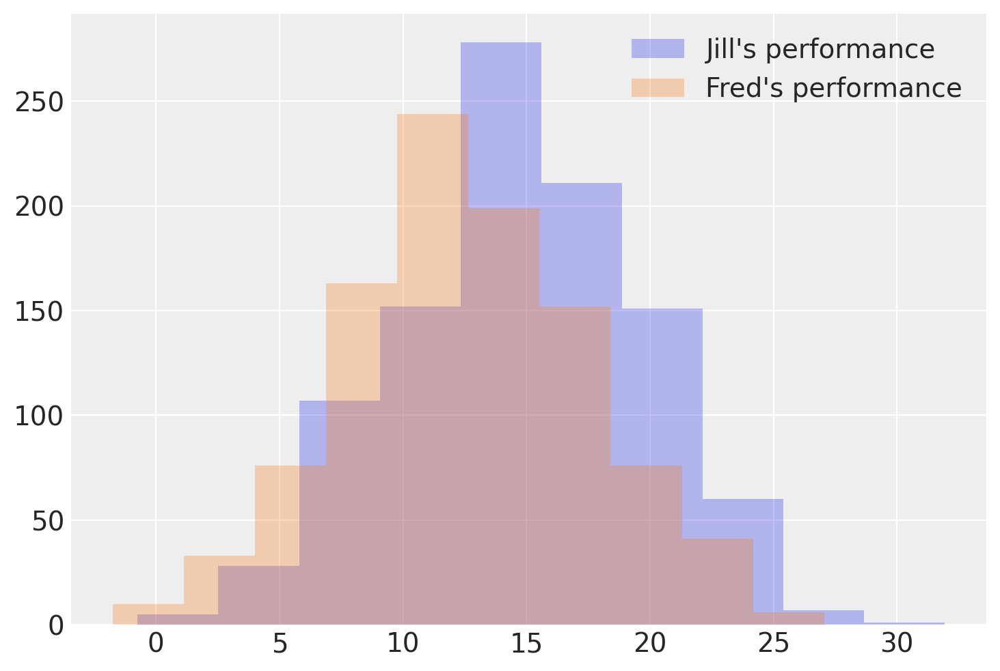

In [6]:
plt.hist(sim_prior['JPerf'], alpha=0.3, label="Jill's performance")
plt.hist(sim_prior['FPerf'], alpha=0.3, label="Fred's performance")
plt.legend();

<AxesSubplot:xlabel='FPerf', ylabel='JPerf'>

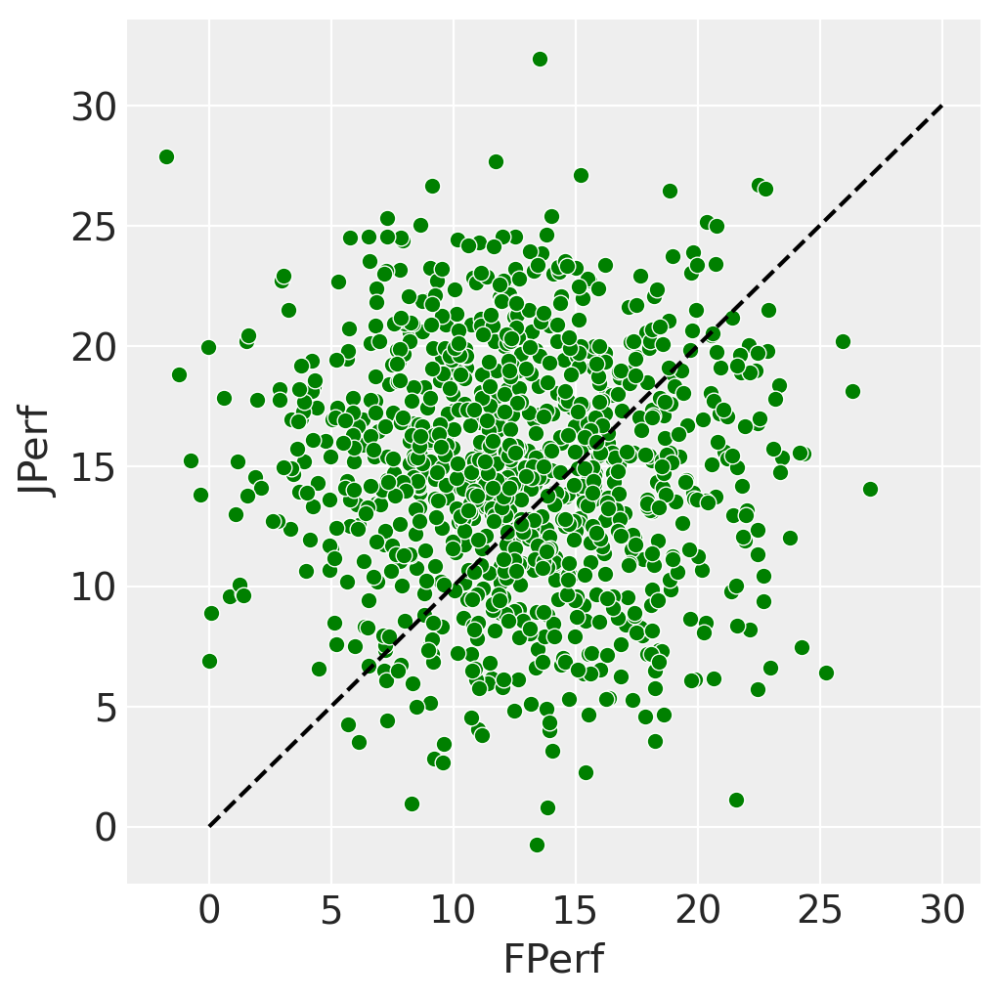

In [7]:
plt.figure(figsize=(5, 5))
x = np.linspace(0, 30)
sns.scatterplot(data=sim_prior, x='FPerf', y='JPerf', color='green')
pd.Series(x, index=x).plot(color='k', ls='--')

## [3. Inferring player's skills](https://mbmlbook.com/TrueSkill_Inferring_the_players_skills.html)

    "So far we have assumed that we know the skills of Jill and Fred, and we have used these skills to compute the probability that each of the players would be the winner. In practice, we have to reason backwards: we observe who wins the game and need to use this information to learn about the skill values of the players. We therefore turn to the problem of learning player skills."
    
    ...
 
 
     "Put concisely, the degree of surprise gives an indication of how big a change in skill values should be made. We will see that performing inference in a suitable model automatically gives this kind of behaviour."

    
    Assumption 1: Each player has a skill value, represented by a continuous variable with a Gaussian prior distribution.
    
    Assumption 2: Each player has a performance value for each game, which is independent from game to game and has an average value is equal to the skill of that player. The variation in performance, which is the same for all players, is symmetrically distributed around the mean value and is more likely to be close to the mean than to be far from the mean.

    Assumptoin 3The player with the higher performance value wins the game. 

    "However, if we looked at the skills of a large population of players we might find a rather non-Gaussian distribution of skills, for example, new players may often have low skill but, if they have played a similar game before, may occasionally have a high skill."


https://docs.pymc.io/en/v3/pymc-examples/examples/pymc3_howto/data_container.html

In [8]:
GAME_OUTCOME = [1, 0] # Jill wins, Fred wins

In [9]:
with pm.Model() as failed:
    
    data = pm.Data('data', GAME_OUTCOME[0])
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
    Jwins = pm.Deterministic("Jwins", pm.math.switch(JPerf > FPerf, 1, 0), observed=data)

    trace = pm.sample(10000, tune=2000, return_inferencedata=True, random_seed=3910101)
pm.model_to_graphviz(model)

TypeError: Deterministic() got an unexpected keyword argument 'observed'

I'm not the only one who stumbles on this problem:
* https://discourse.pymc.io/t/observed-deterministic/483
* https://stats.stackexchange.com/questions/416725/observed-deterministic-variables-in-mcmc



This [blog post](http://www.awebb.info/probability/inference/mcmc/2017/02/22/observing-functions-of-random-variables-in-pymc.html) summarises it succinctly: 

    In order to understand why this is not possible, we need to remind ourselves how MCMC sampling works.

    First, the values of all stochastic, non-observed nodes are initialised randomly. Then, a new position in the space of possible values for each of these nodes is considered. Whether we move to the new location depends on the value of the posterior distribution at the old location and at the new location, and this process is repeated.

    Note that because xs is a deterministic function of its parents, the likelihood function for a given value of x
    x, p(x∣α,β,θ)p(x∣α,β,θ) is zero for almost all values of αα, ββ, and θθ. As a result, the posterior distribution is also zero almost everywhere. Since almost everywhere the MCMC process looks, it sees a posterior probability of zero, it has no way to explore the space effectively.



### Options to proceed:
* Do a hacky solution and specify some random variable mimicking the deterministic varaible
* Use the closed-form solution for likelihood
* use an appromixate algorithm
* use expectation-maximisation, as the in the book, thoug hthat would defeat the purpose of learning the pymc



### Option 1: Hacky way



Passing a a probability that is itself bound to 0/1 to Bernouilli does not look like a good idea, let's see what happens

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [FPerf, JPerf, FSkill, JSkill]


Sampling 4 chains for 2_000 tune and 10_000 draw iterations (8_000 + 40_000 draws total) took 29 seconds.
There were 4149 divergences after tuning. Increase `target_accept` or reparameterize.
The acceptance probability does not match the target. It is 0.8845165396074018, but should be close to 0.8. Try to increase the number of tuning steps.
There were 4678 divergences after tuning. Increase `target_accept` or reparameterize.
There were 5113 divergences after tuning. Increase `target_accept` or reparameterize.
The acceptance probability does not match the target. It is 0.6622453032759361, but should be close to 0.8. Try to increase the number of tuning steps.
There were 4614 divergences after tuning. Increase `target_accept` or reparameterize.
The number of effective samples is smaller than 25% for some parameters.


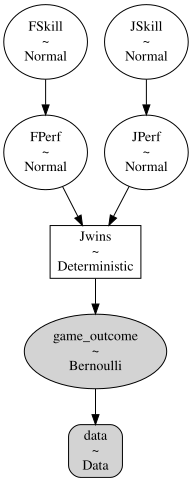

In [10]:
with pm.Model() as model:
    
    data = pm.Data('data', GAME_OUTCOME[0])
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
    Jwins = pm.Deterministic("Jwins", pm.math.switch(JPerf > FPerf, 1, 0))
    
    game_outcome = pm.Bernoulli('game_outcome', Jwins, observed=data)
    trace = pm.sample(10000, tune=2000, return_inferencedata=True, random_seed=3910101)
pm.model_to_graphviz(model)

Warning are not good. Increasing the number of samples does not help.

https://discourse.pymc.io/t/there-were-6-divergences-after-tuning-increase-target-accept-or-reparameterize/6458/4

In [11]:
# ancestral sampling
sim_prior = pm.sample_prior_predictive(samples=10000, model=model, random_seed=199)

In [12]:
trace['posterior']['JSkill'].shape

(4, 10000)

array([[<AxesSubplot:title={'center':'JSkill'}>,
        <AxesSubplot:title={'center':'JSkill'}>],
       [<AxesSubplot:title={'center':'FSkill'}>,
        <AxesSubplot:title={'center':'FSkill'}>],
       [<AxesSubplot:title={'center':'JPerf'}>,
        <AxesSubplot:title={'center':'JPerf'}>],
       [<AxesSubplot:title={'center':'FPerf'}>,
        <AxesSubplot:title={'center':'FPerf'}>],
       [<AxesSubplot:title={'center':'Jwins'}>,
        <AxesSubplot:title={'center':'Jwins'}>]], dtype=object)

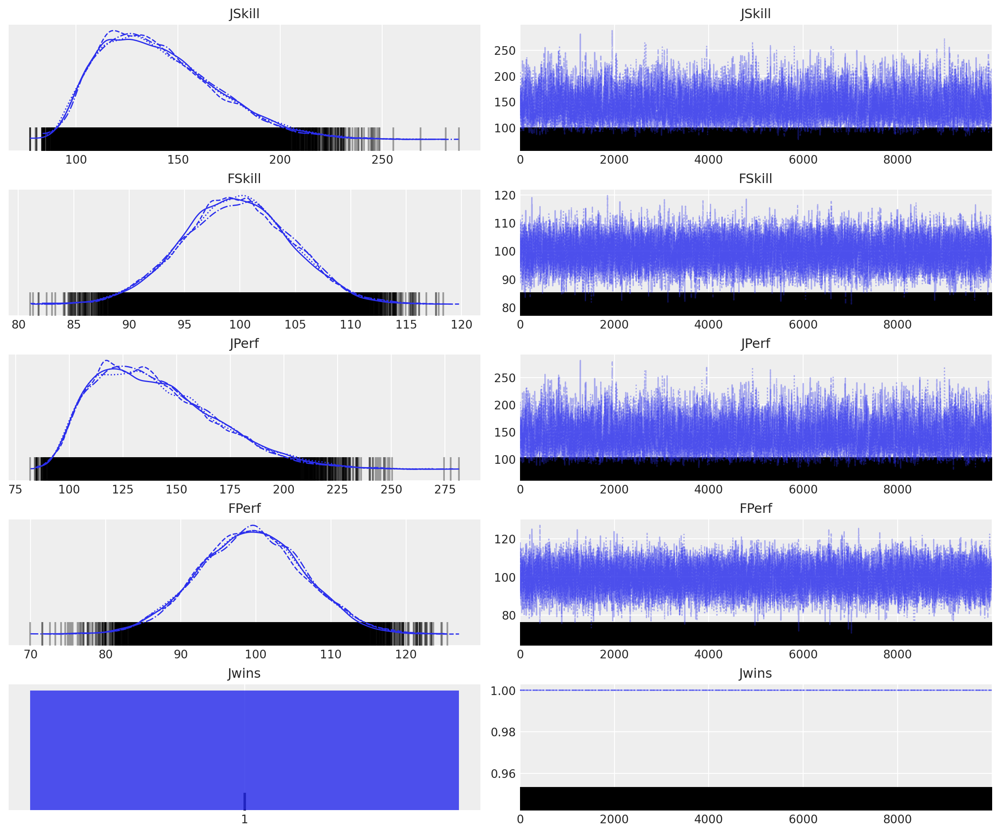

In [13]:
az.plot_trace(trace)

Distribution of Jill's skills looks suspiciously skewed.

<AxesSubplot:>

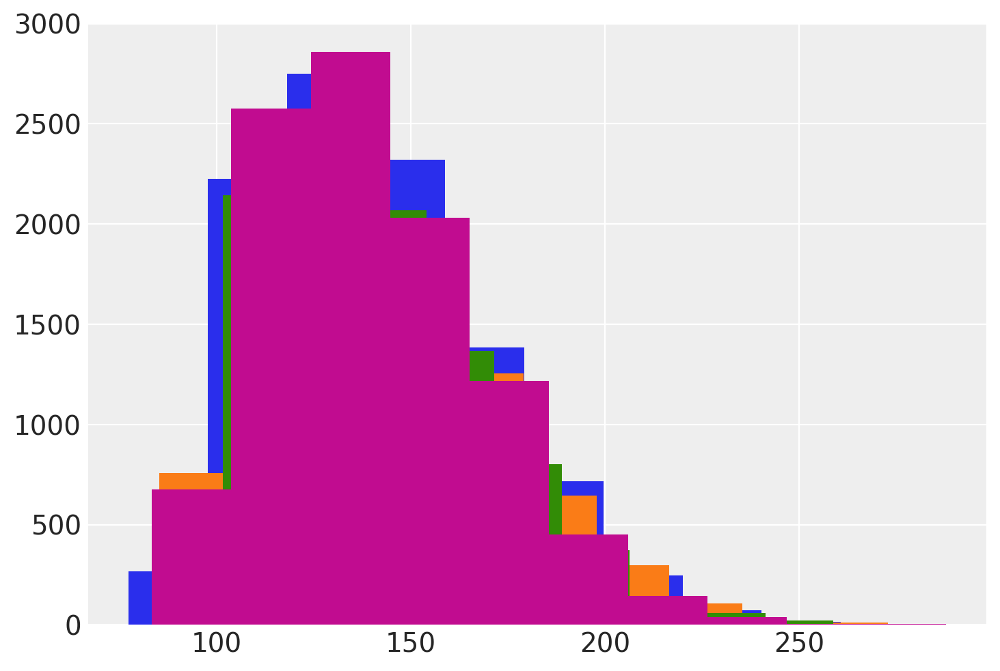

In [14]:
pd.Series(trace['posterior']['JSkill'][0]).hist()
pd.Series(trace['posterior']['JSkill'][1]).hist()
pd.Series(trace['posterior']['JSkill'][2]).hist()
pd.Series(trace['posterior']['JSkill'][3]).hist()

<AxesSubplot:>

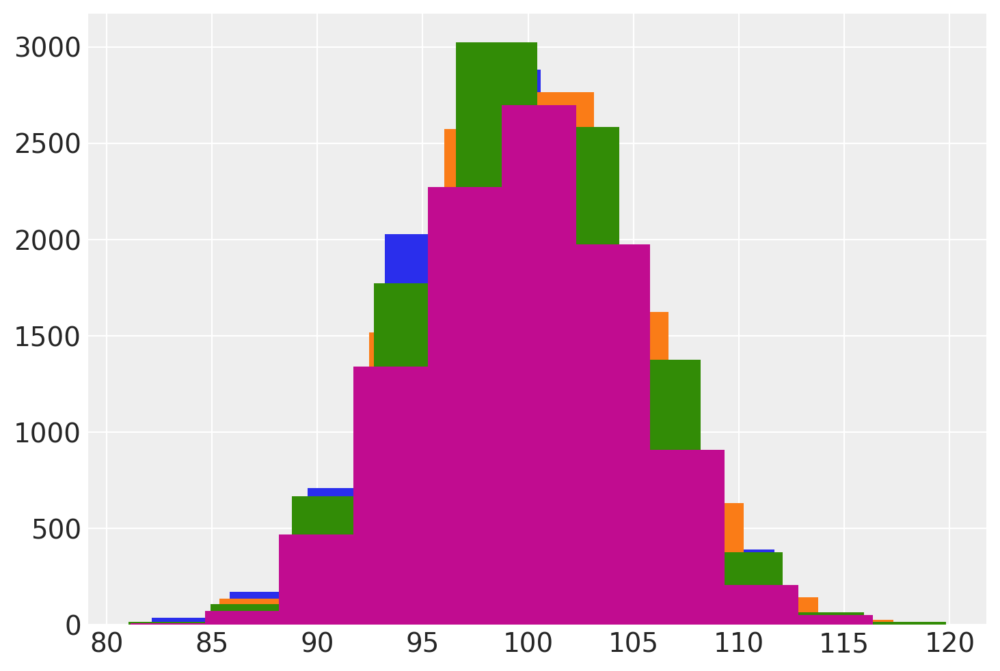

In [15]:
pd.Series(trace['posterior']['FSkill'][0]).hist()
pd.Series(trace['posterior']['FSkill'][1]).hist()
pd.Series(trace['posterior']['FSkill'][2]).hist()
pd.Series(trace['posterior']['FSkill'][3]).hist()

https://docs.pymc.io/en/v3/pymc-examples/examples/diagnostics_and_criticism/Diagnosing_biased_Inference_with_Divergences.html

In [16]:
az.summary(trace)

/Users/amosin/opt/anaconda3/envs/pymc3_env/lib/python3.9/site-packages/arviz/stats/diagnostics.py:561: RuntimeWarning: invalid value encountered in double_scalars
  (between_chain_variance / within_chain_variance + num_samples - 1) / (num_samples)


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
JSkill,140.143,28.372,93.214,192.041,0.375,0.265,5347.0,5975.0,1.0
FSkill,99.725,4.976,90.452,109.044,0.050,0.036,9774.0,12482.0,1.0
JPerf,140.424,28.393,95.297,193.122,0.374,0.264,5428.0,6601.0,1.0
FPerf,99.438,7.027,85.860,112.242,0.070,0.050,9955.0,12865.0,1.0
Jwins,1.000,0.000,1.000,1.000,0.000,0.000,40000.0,40000.0,NaN


In [20]:
trace['posterior']['Jwins']

<xarray.DataArray 'Jwins' (chain: 4, draw: 10000)>
array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=int8)
Coordinates:
  * chain    (chain) int64 0 1 2 3
  * draw     (draw) int64 0 1 2 3 4 5 6 7 ... 9993 9994 9995 9996 9997 9998 9999

I'll come back it. For now, want to see if I can still reproduce the graph.

#### Scenario 1: Jill wins

This graph does look similar to [Figure 3.9](https://mbmlbook.com/TrueSkill_A_solution__expectation_propagation.html), though the variance of posterior distribution is smaller in my case.

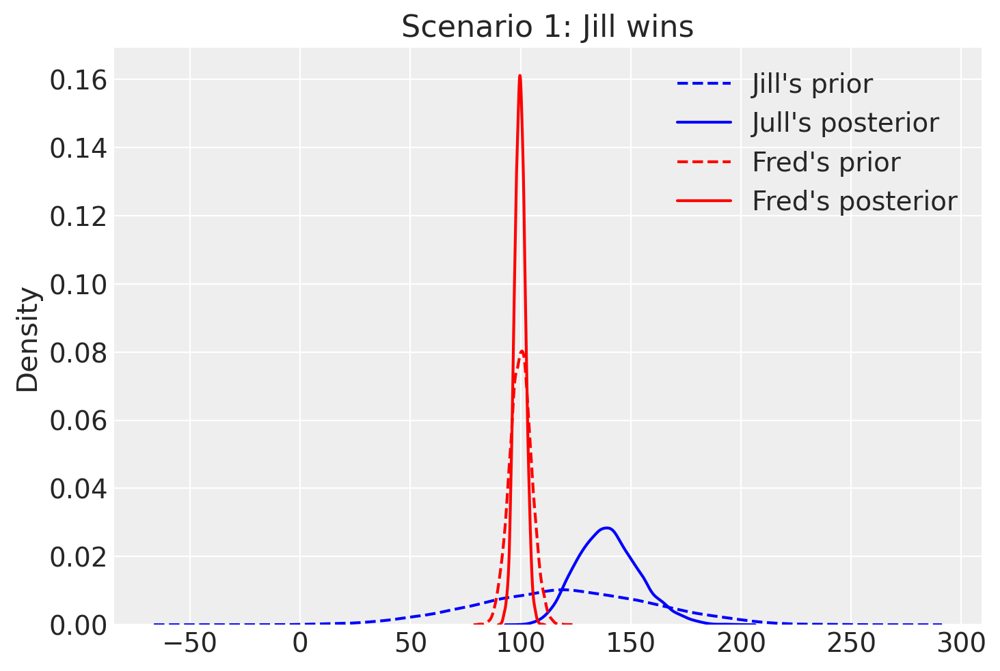

In [18]:
sns.kdeplot(sim_prior['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(trace['posterior']['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(sim_prior['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(trace['posterior']['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

_ = plt.legend()
_ = plt.title('Scenario 1: Jill wins')

In [19]:
with model:
    pm.set_data({"data": GAME_OUTCOME[1]})
    trace = pm.sample(return_inferencedata=True, random_seed=3910101)

SamplingError: Initial evaluation of model at starting point failed!
Starting values:
{'JSkill': array(120.), 'FSkill': array(100.), 'JPerf': array(120.), 'FPerf': array(100.)}

Initial evaluation results:
JSkill         -4.61
FSkill         -2.53
JPerf          -2.53
FPerf          -2.53
game_outcome    -inf
Name: Log-probability of test_point, dtype: float64

Yes, the hacky way bites me.

### Option 2: Exact likelihood

[The equation 3.10](https://mbmlbook.com/TrueSkill_Modelling_the_outcome_of_games.html) provides exact answer for the probability of Jill having a higher performance

    P(Jperf>Fperf|Jskill,Fskill)=CumGauss[(Jskill−Fskill) * 1 / √2*perfSD]

https://docs.pymc.io/en/v3/pymc-examples/examples/case_studies/blackbox_external_likelihood.html

In [21]:
#https://discourse.pymc.io/t/smc-example-with-arbitrary-function-as-model-likelihood/3249
# https://docs.pymc.io/en/v3/pymc-examples/examples/ode_models/ODE_with_manual_gradients.html#Define-a-non-differentiable-black-box-op-using-Theano-@as_op

import theano.tensor as tt
from theano.compile.ops import as_op
import scipy.stats as st

@as_op(itypes=[tt.dscalar, tt.dscalar, tt.dscalar], otypes=[tt.dscalar])
def cum_gaussian(skill_a, skill_b, skill_sd):    
    x = (skill_a - skill_b) / (np.sqrt(2) * skill_sd)
    return np.array(st.norm.cdf(x, loc=0, scale=1))

Have to use 1 core due to this bug on Mac  https://github.com/pymc-devs/pymc/issues/4085

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Initializing NUTS failed. Falling back to elementwise auto-assignment.
Sequential sampling (2 chains in 1 job)
CompoundStep
>CompoundStep
>>Slice: [FSkill]
>>Slice: [JSkill]
>NUTS: [FPerf, JPerf]


Sampling 2 chains for 5_000 tune and 10_000 draw iterations (10_000 + 20_000 draws total) took 70 seconds.
The acceptance probability does not match the target. It is 0.6693735595898799, but should be close to 0.8. Try to increase the number of tuning steps.
The acceptance probability does not match the target. It is 0.951613222360822, but should be close to 0.8. Try to increase the number of tuning steps.
The estimated number of effective samples is smaller than 200 for some parameters.


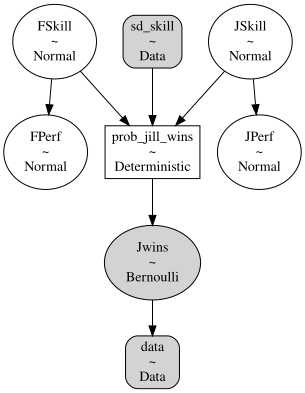

In [22]:
with pm.Model() as model:
    
    data = pm.Data('data', GAME_OUTCOME[0])
    sd_skill = pm.Data('sd_skill', 5.0)
    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
    
    prob_jill_wins = pm.Deterministic('prob_jill_wins', cum_gaussian(JSkill, FSkill, sd_skill))
    Jwins = pm.Bernoulli("Jwins", p=prob_jill_wins, observed=data)
    
    
    trace = pm.sample(10000, tune=5000, return_inferencedata=True, random_seed=3910101, cores=1)
pm.model_to_graphviz(model)

In [23]:
# ancestral sampling
sim_prior = pm.sample_prior_predictive(samples=10000, model=model, random_seed=199)

In [24]:
az.summary(trace)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
JSkill,138.427,27.974,92.915,191.379,2.106,1.491,181.0,484.0,1.01
FSkill,99.782,4.998,90.147,108.944,0.090,0.064,3077.0,6125.0,1.00
JPerf,138.390,28.409,92.119,193.372,2.143,1.518,180.0,491.0,1.01
FPerf,99.899,7.141,86.500,113.009,0.154,0.109,2148.0,3440.0,1.00
prob_jill_wins,0.944,0.153,0.648,1.000,0.006,0.004,210.0,1874.0,1.01


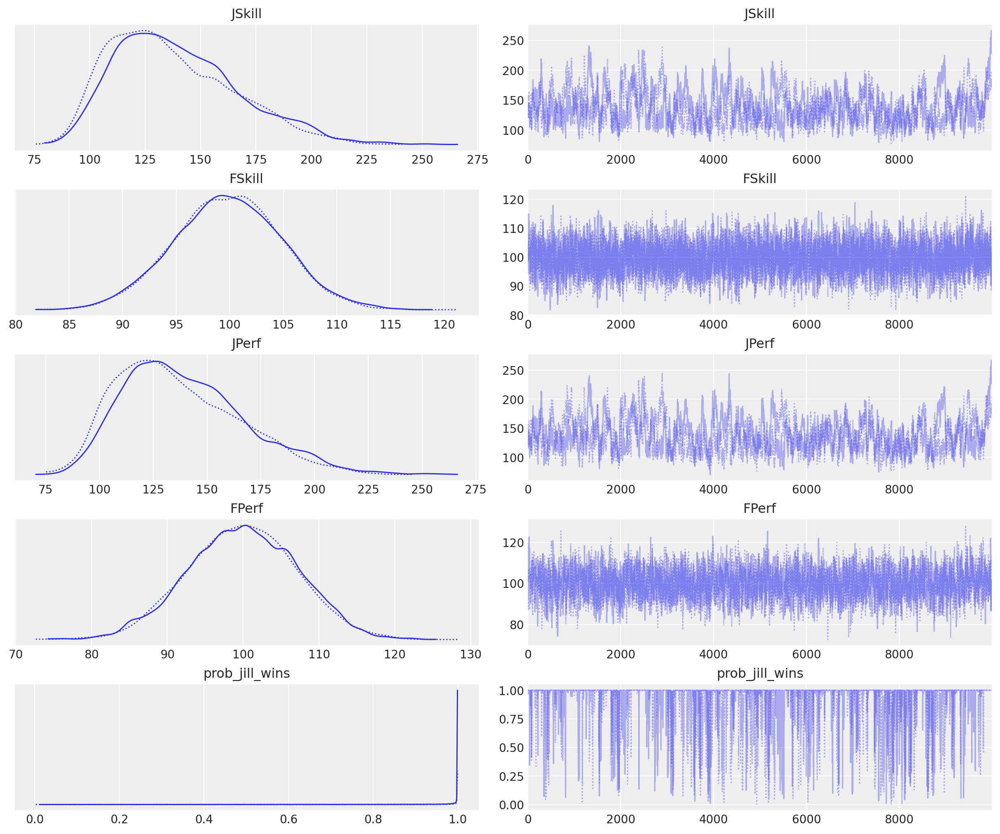

In [25]:
az.plot_trace(trace);

Still, the JSkill seems to be correlated

<AxesSubplot:>

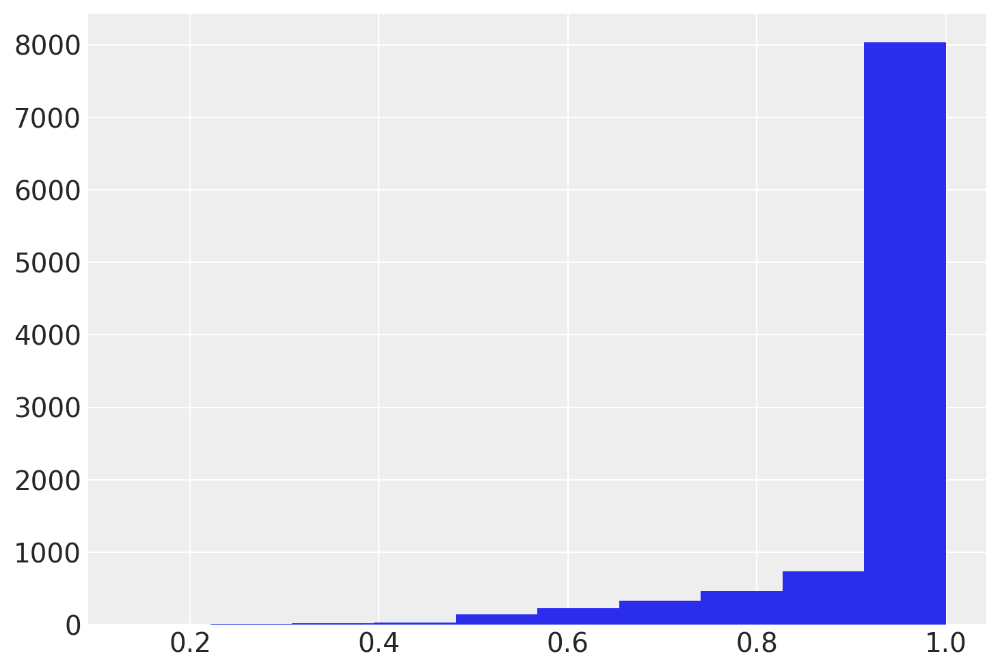

In [26]:
pd.Series(trace['posterior']['prob_jill_wins'].mean(axis=0)).hist()

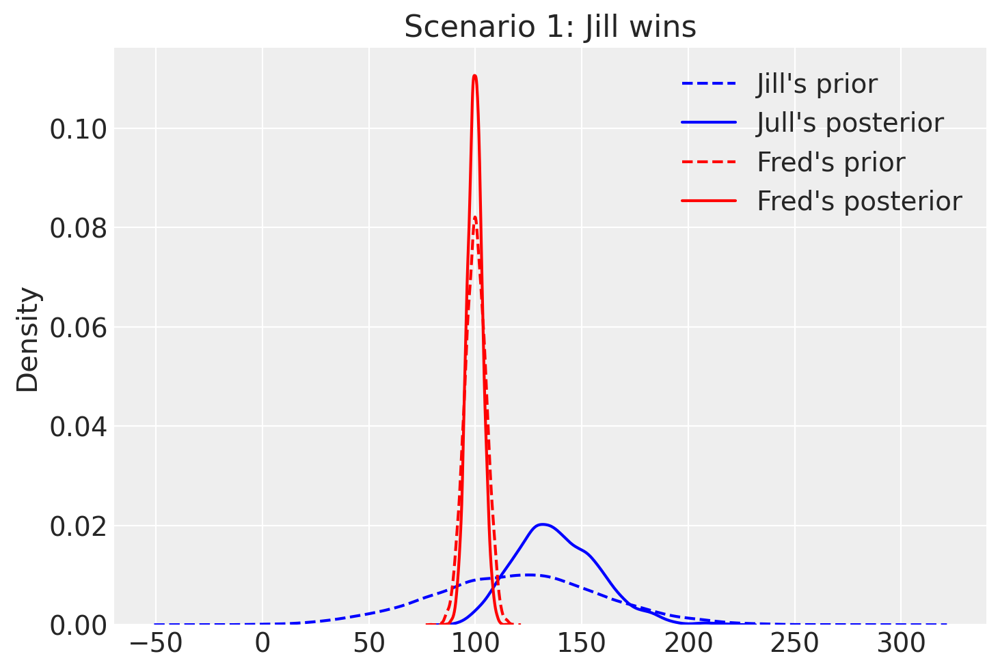

In [27]:
sns.kdeplot(sim_prior['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(trace['posterior']['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(sim_prior['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(trace['posterior']['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

_ = plt.legend()
_ = plt.title('Scenario 1: Jill wins')

In [28]:
with model:
    pm.set_data({"data": GAME_OUTCOME[1]})
    trace = pm.sample(return_inferencedata=True, random_seed=3910101, cores=1)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Initializing NUTS failed. Falling back to elementwise auto-assignment.
Sequential sampling (2 chains in 1 job)
CompoundStep
>CompoundStep
>>Slice: [FSkill]
>>Slice: [JSkill]
>NUTS: [FPerf, JPerf]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 9 seconds.
The estimated number of effective samples is smaller than 200 for some parameters.


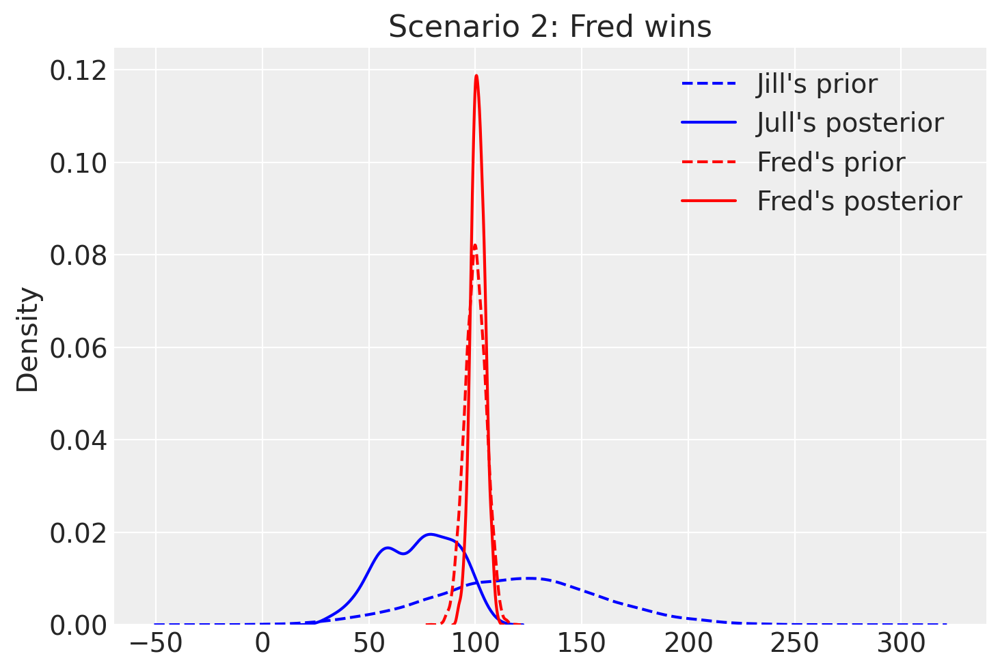

In [29]:
sns.kdeplot(sim_prior['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(trace['posterior']['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(sim_prior['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(trace['posterior']['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

_ = plt.legend()
_ = plt.title('Scenario 2: Fred wins')

Compare to [Figure 3.10](https://mbmlbook.com/TrueSkill_A_solution__expectation_propagation.html)

### Option 3: Use inverse logit to transform the difference of two gaussians into probabilities

Note that this transformation This introduces additional noise into the model. E.g. even if Jill has a higher skill than Fred, but the difference is small (say, 0.5) then it's 50/50 whether she wins.

In [30]:
pm.math.invlogit(120-119.5).eval()

array(0.62245933)

In [31]:
pm.math.invlogit(0.5).eval()

array(0.62245933)

In [32]:
pm.math.invlogit(1).eval()

array(0.73105861)

Nevertheless, the impact might not be substantial, because for differences higher than +/-5 the outcome is almost certain.

In [33]:
pm.math.invlogit(10).eval()

array(0.99995458)

In [34]:
pm.math.invlogit(5).eval()

array(0.99330715)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Sequential sampling (2 chains in 1 job)
NUTS: [FPerf, JPerf, FSkill, JSkill]


Sampling 2 chains for 5_000 tune and 10_000 draw iterations (10_000 + 20_000 draws total) took 31 seconds.
The number of effective samples is smaller than 25% for some parameters.


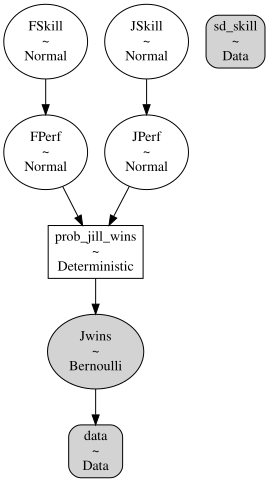

In [35]:
with pm.Model() as model:
    
    data = pm.Data('data', GAME_OUTCOME[0])
    sd_skill = pm.Data('sd_skill', 5.0)
    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
    
    prob_jill_wins = pm.Deterministic('prob_jill_wins', pm.math.invlogit(JPerf - FPerf))
    Jwins = pm.Bernoulli("Jwins", p=prob_jill_wins, observed=data)
    
    trace = pm.sample(10000, tune=5000, return_inferencedata=True, random_seed=3910101, cores=1)
pm.model_to_graphviz(model)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Sequential sampling (2 chains in 1 job)
NUTS: [FPerf, JPerf, FSkill, JSkill]


Sampling 2 chains for 5_000 tune and 10_000 draw iterations (10_000 + 20_000 draws total) took 32 seconds.
The number of effective samples is smaller than 25% for some parameters.


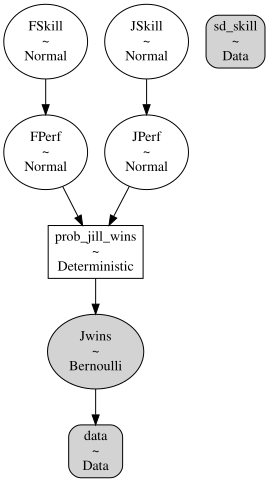

In [36]:
with pm.Model() as model:
    
    data = pm.Data('data', GAME_OUTCOME[0])
    sd_skill = pm.Data('sd_skill', 5.0)
    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
    
    prob_jill_wins = pm.Deterministic('prob_jill_wins', pm.math.invlogit(JPerf - FPerf))
    Jwins = pm.Bernoulli("Jwins", p=prob_jill_wins, observed=data)
    
    trace = pm.sample(10000, tune=5000, return_inferencedata=True, random_seed=3910101, cores=1)
pm.model_to_graphviz(model)

In [37]:
# ancestral sampling
sim_prior = pm.sample_prior_predictive(samples=10000, model=model, random_seed=199)

In [38]:
az.summary(trace)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
JSkill,140.329,28.769,94.021,195.209,0.456,0.322,3907.0,5026.0,1.0
FSkill,99.596,4.936,90.329,108.908,0.063,0.045,6143.0,7546.0,1.0
JPerf,140.655,28.801,94.703,194.593,0.456,0.322,3931.0,5404.0,1.0
FPerf,99.307,6.981,86.323,112.513,0.089,0.063,6217.0,7261.0,1.0
prob_jill_wins,0.986,0.087,0.989,1.000,0.001,0.001,4616.0,6710.0,1.0


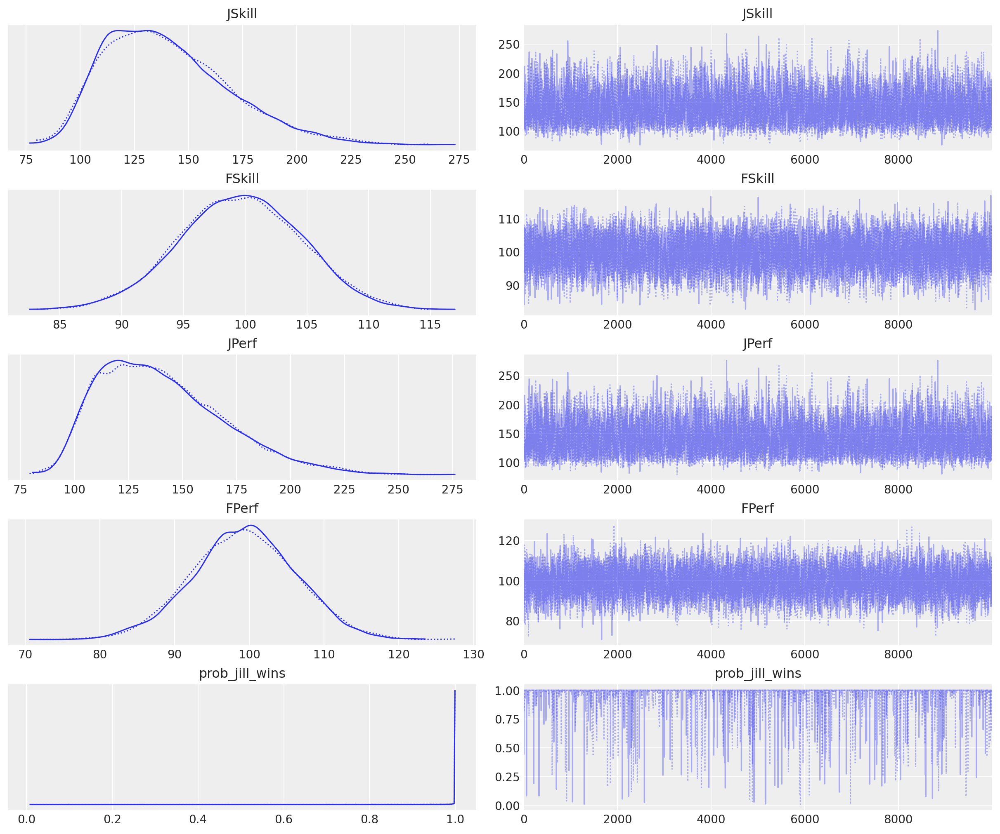

In [39]:
az.plot_trace(trace);

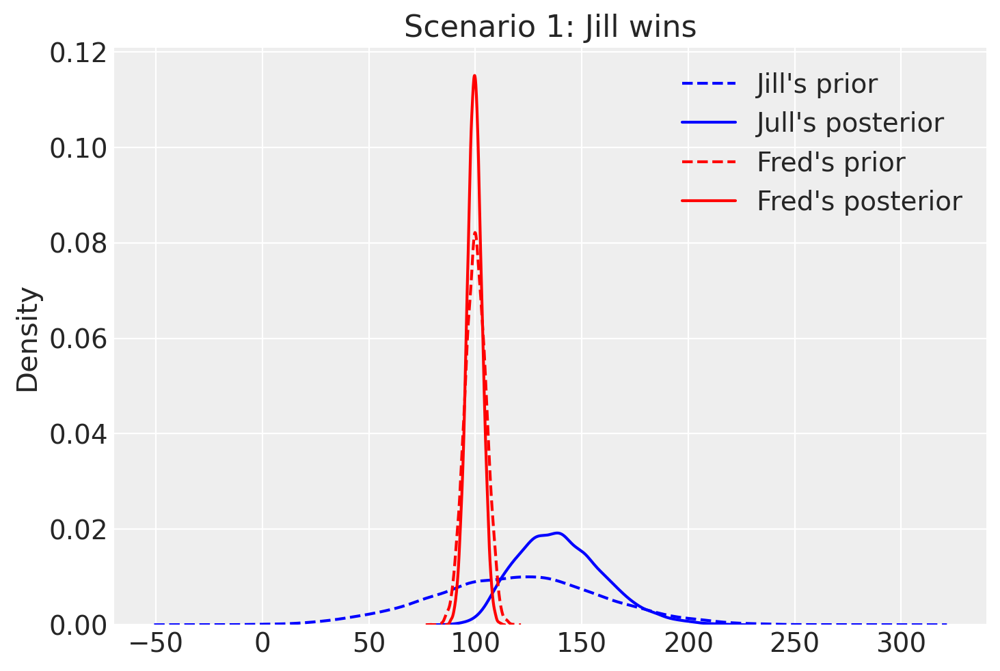

In [40]:
sns.kdeplot(sim_prior['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(trace['posterior']['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(sim_prior['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(trace['posterior']['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

_ = plt.legend()
_ = plt.title('Scenario 1: Jill wins')

In [41]:
trace['posterior']

<xarray.Dataset>
Dimensions:         (chain: 2, draw: 10000)
Coordinates:
  * chain           (chain) int64 0 1
  * draw            (draw) int64 0 1 2 3 4 5 6 ... 9994 9995 9996 9997 9998 9999
Data variables:
    JSkill          (chain, draw) float64 117.3 102.5 119.9 ... 130.9 115.3
    FSkill          (chain, draw) float64 100.6 107.5 104.1 ... 99.37 100.8
    JPerf           (chain, draw) float64 115.6 104.6 119.0 ... 137.3 113.4
    FPerf           (chain, draw) float64 97.58 104.9 95.07 ... 103.7 99.95
    prob_jill_wins  (chain, draw) float64 1.0 0.4432 1.0 0.9999 ... 1.0 1.0 1.0
Attributes:
    created_at:                 2022-09-24T10:43:48.117890
    arviz_version:              0.11.4
    inference_library:          pymc3
    inference_library_version:  3.11.4
    sampling_time:              32.42182803153992
    tuning_steps:               5000

<AxesSubplot:>

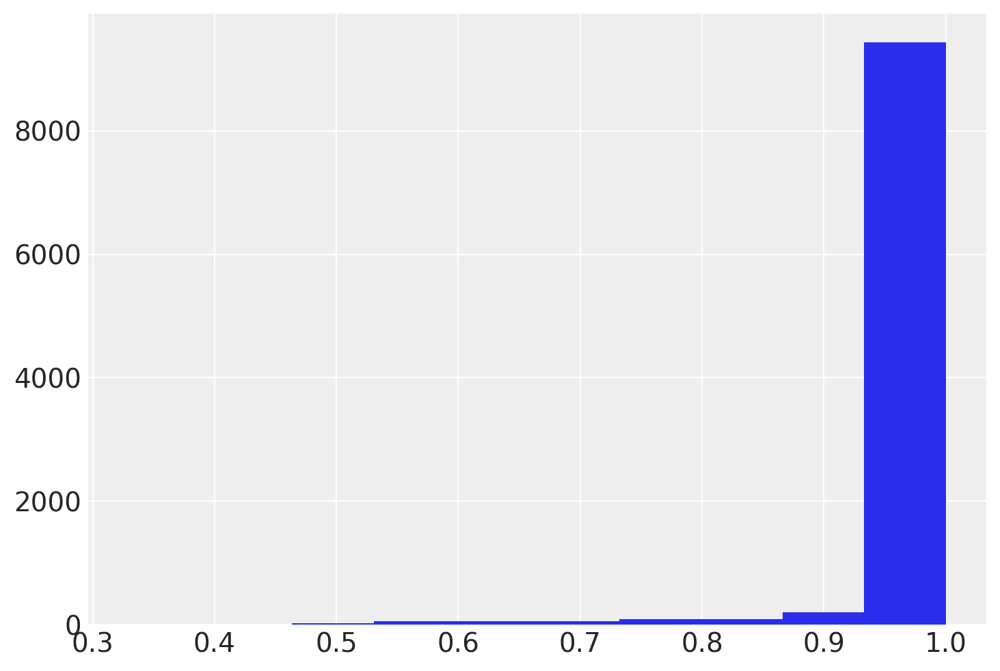

In [42]:
pd.Series(trace['posterior']['prob_jill_wins'].mean(axis=0)).hist()

In [43]:
trace['posterior']['prob_jill_wins']

<xarray.DataArray 'prob_jill_wins' (chain: 2, draw: 10000)>
array([[0.99999998, 0.44316374, 1.        , ..., 0.99290268, 0.99290268,
        0.99290268],
       [0.99999681, 0.99999993, 0.99999993, ..., 1.        , 1.        ,
        0.99999853]])
Coordinates:
  * chain    (chain) int64 0 1
  * draw     (draw) int64 0 1 2 3 4 5 6 7 ... 9993 9994 9995 9996 9997 9998 9999

In [44]:
with model:
    pm.set_data({"data": GAME_OUTCOME[1]})
    trace = pm.sample(return_inferencedata=True, random_seed=3910101, cores=1)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Sequential sampling (2 chains in 1 job)
NUTS: [FPerf, JPerf, FSkill, JSkill]


Sampling 2 chains for 1_000 tune and 1_000 draw iterations (2_000 + 2_000 draws total) took 4 seconds.


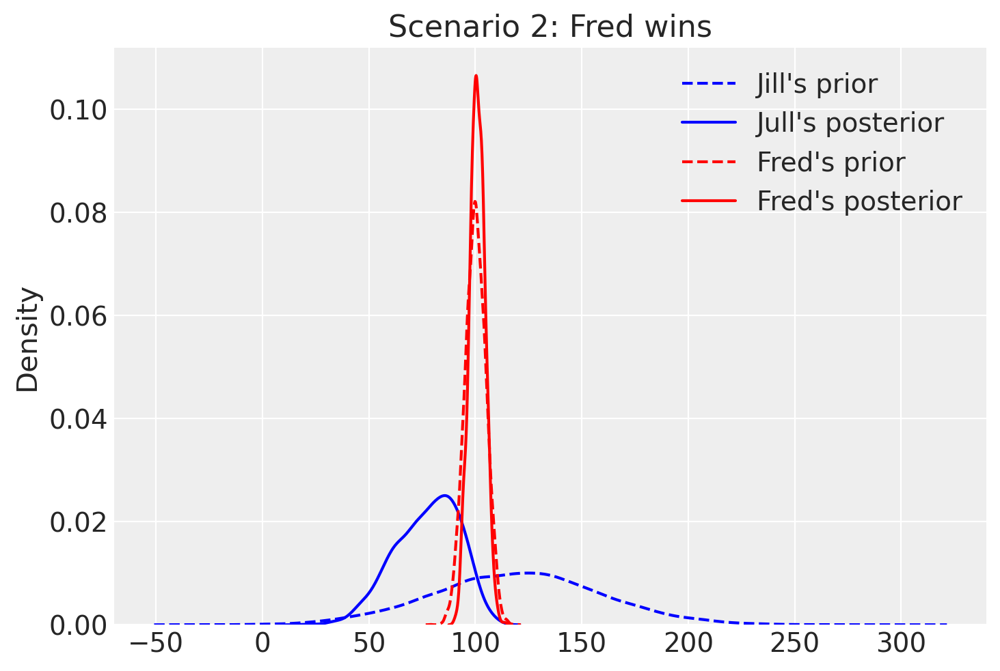

In [45]:
sns.kdeplot(sim_prior['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(trace['posterior']['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(sim_prior['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(trace['posterior']['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

_ = plt.legend()
_ = plt.title('Scenario 2: Fred wins')

Great, it loos similar, though one issue remains: the distribution of posterior skill for Jill is right-skewed, and the posterior does not reach the 20s levels of skills, as the original figure in the book

### Option 4: simulation-based inference 

* https://docs.pymc.io/en/v3/pymc-examples/examples/samplers/SMC-ABC_Lotka-Volterra_example.html
* https://docs.pymc.io/en/v3/pymc-examples/examples/samplers/SMC2_gaussians.html



    "Approximate Bayesian Computation methods (also called likelihood free inference methods), are a group of techniques developed for inferring posterior distributions in cases where the likelihood function is intractable or costly to evaluate. This does not mean that the likelihood function is not part of the analysis, it just the we are approximating the likelihood, and hence the name of the ABC methods."
    
https://www.pymc.io/projects/examples/en/latest/samplers/SMC2_gaussians.html?highlight=sequential%20monte%20carlo#sequential-monte-carlo

In [46]:
def winner_simulator(JPerf: float, FPerf: float) -> int:
    return np.array([int(JPerf > FPerf)])

Initializing SMC sampler...
Sampling 4 chains in 4 jobs
Stage:   0 Beta: 1.000
Stage:   0 Beta: 1.000
Stage:   0 Beta: 1.000
Stage:   0 Beta: 1.000


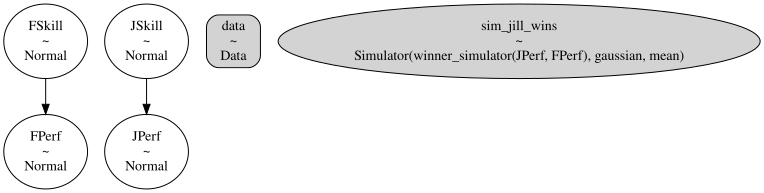

In [47]:
with pm.Model() as model:
    
    data = pm.Data('data', GAME_OUTCOME[0])
#    sd_perf = pm.Data('sd_perf', 5.0, muteable=False)
    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
 
    sim_jill_wins = pm.Simulator('sim_jill_wins',
                                 winner_simulator, 
                                 params=[JPerf, FPerf],
                                 sum_stat='mean', 
                                 observed=np.array(GAME_OUTCOME)[:1],
                                 epsilon=1
                                )
    
    trace, sim_data = pm.sample_smc(draws=5000, tune_steps=1000, kernel="ABC", parallel=False, save_sim_data=True,  random_seed=3910101)
    idata = az.from_pymc3(trace, posterior_predictive=sim_data)
pm.model_to_graphviz(model)

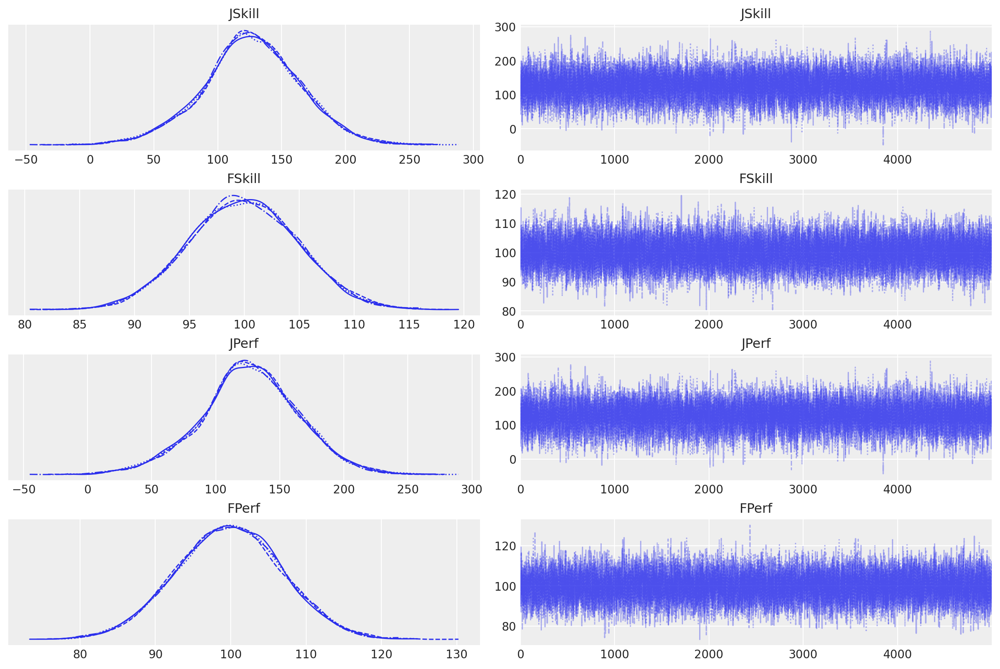

In [48]:
az.plot_trace(idata);

In [49]:
#az.plot_ppc(idata);

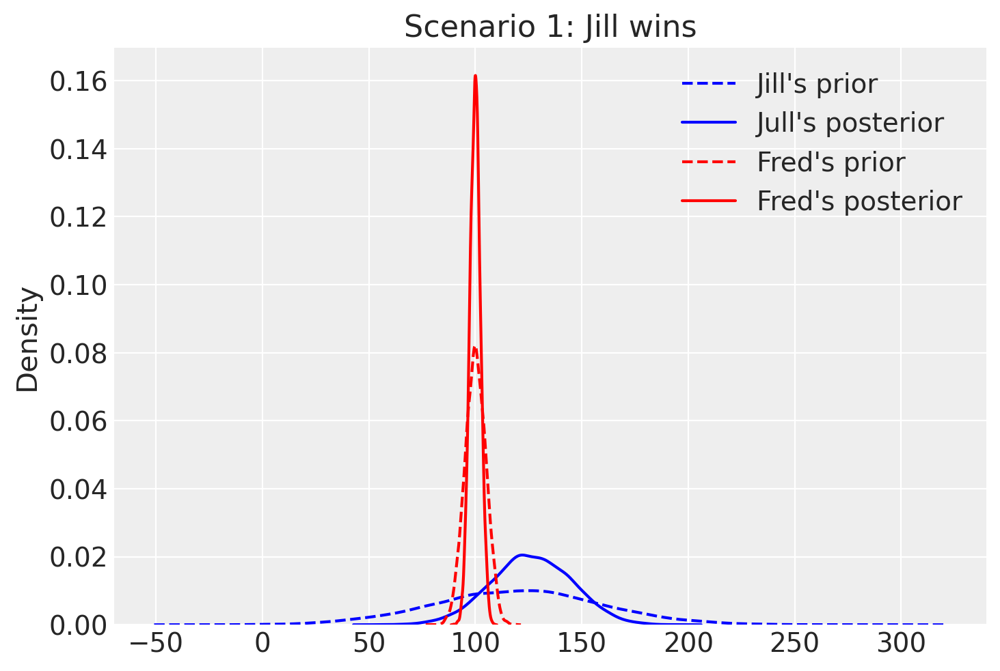

In [50]:
sns.kdeplot(sim_prior['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(idata.posterior['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(sim_prior['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(idata.posterior['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

_ = plt.legend()
_ = plt.title('Scenario 1: Jill wins')

In [51]:
sim_data['sim_jill_wins'].mean()

0.785

Initializing SMC sampler...
Sampling 4 chains in 4 jobs
Stage:   0 Beta: 1.000
Stage:   0 Beta: 1.000
Stage:   0 Beta: 1.000
Stage:   0 Beta: 1.000


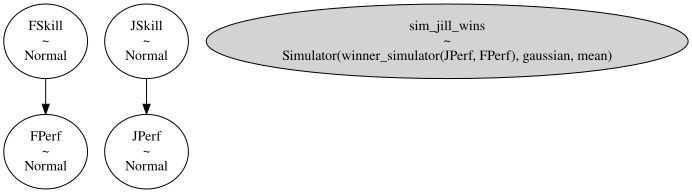

In [52]:
with pm.Model() as model:
    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
 
    sim_jill_wins = pm.Simulator('sim_jill_wins',
                                 winner_simulator, 
                                 params=[JPerf, FPerf],
                                 sum_stat='mean',
                                 observed=np.array(GAME_OUTCOME)[1:],
                                 epsilon=1
                                )
    
    trace, sim_data = pm.sample_smc(draws=5000, tune_steps=1000, kernel="ABC", parallel=False, save_sim_data=True,  random_seed=3910101)
    idata = az.from_pymc3(trace, posterior_predictive=sim_data)
pm.model_to_graphviz(model)

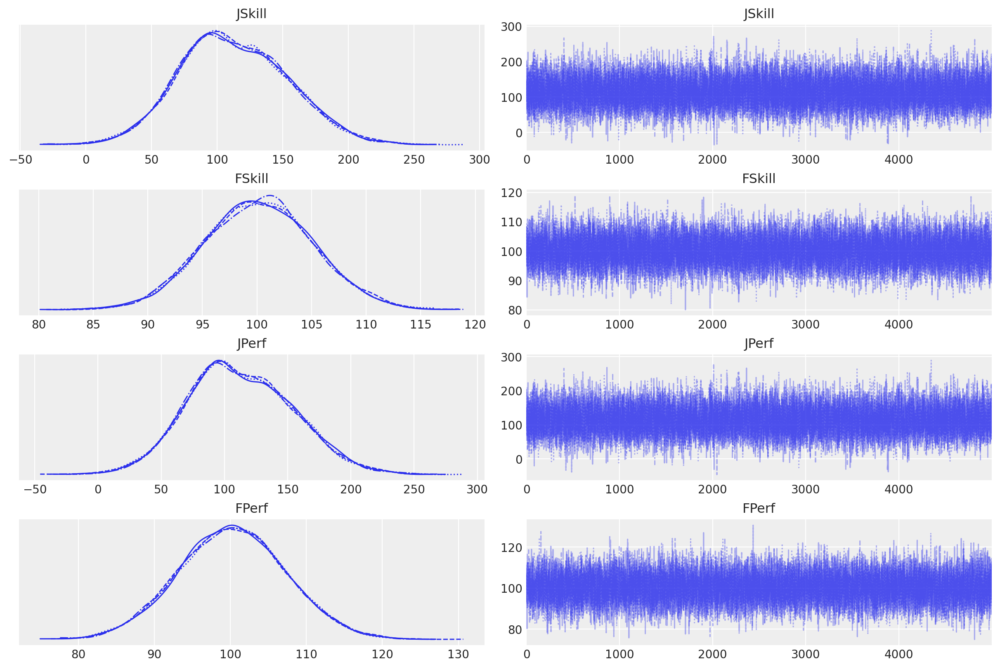

In [53]:
az.plot_trace(idata);

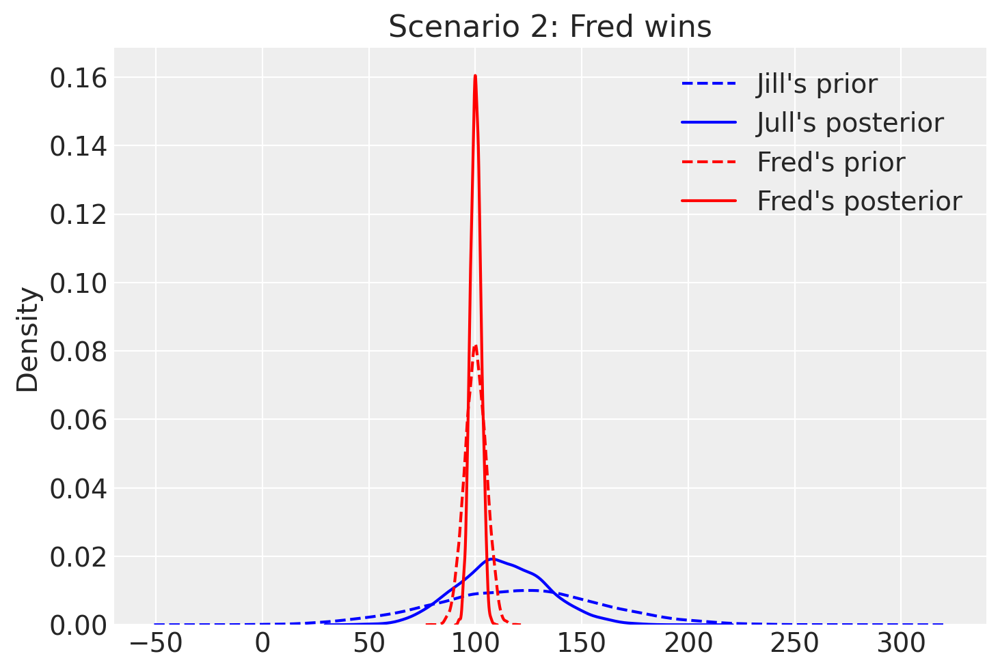

In [54]:
sns.kdeplot(sim_prior['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(idata.posterior['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(sim_prior['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(idata.posterior['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

_ = plt.legend()
_ = plt.title('Scenario 2: Fred wins')

This graph is very off from the origina, try to reduce the epsilon

Initializing SMC sampler...
Sampling 4 chains in 4 jobs
Stage:   0 Beta: 1.000
Stage:   0 Beta: 1.000
Stage:   0 Beta: 1.000
Stage:   0 Beta: 1.000


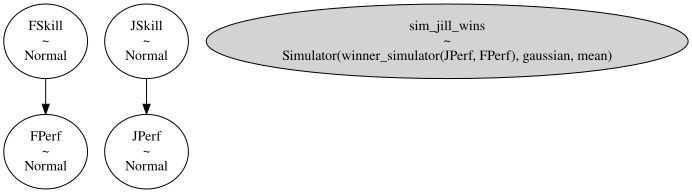

In [55]:
with pm.Model() as model:
    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
 
    sim_jill_wins = pm.Simulator('sim_jill_wins',
                                 winner_simulator,
                                 params=[JPerf, FPerf],
                                 sum_stat='mean',
                                 observed=np.array(GAME_OUTCOME)[1:],
                                 epsilon=.5
                                )
    
    trace, sim_data = pm.sample_smc(draws=5000, tune_steps=1000, kernel="ABC", parallel=False, save_sim_data=True,  random_seed=3910101)
    idata = az.from_pymc3(trace, posterior_predictive=sim_data)
pm.model_to_graphviz(model)

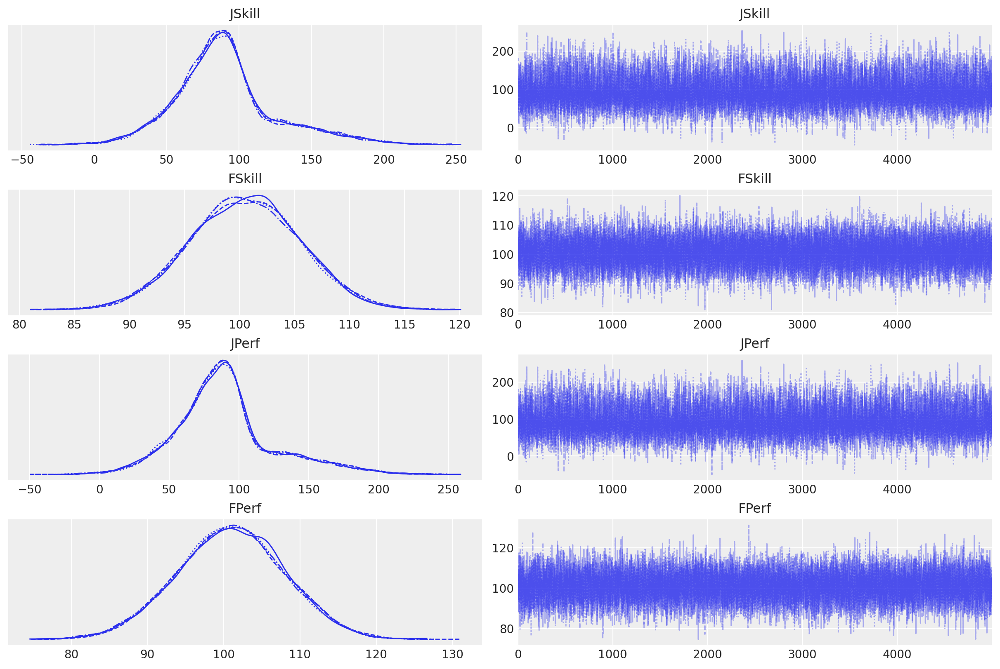

In [56]:
az.plot_trace(idata);

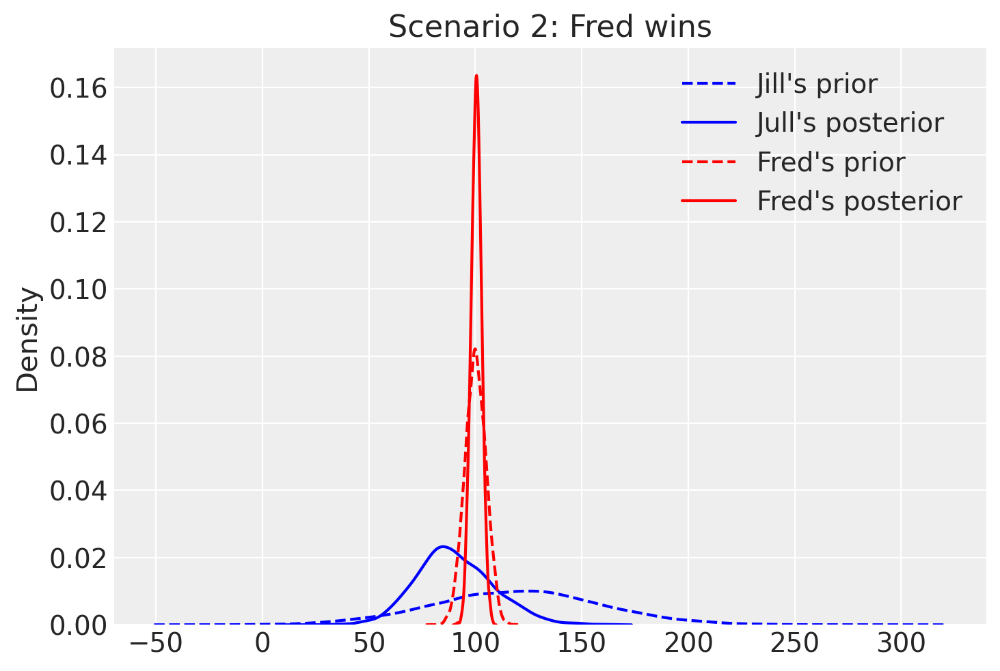

In [57]:
sns.kdeplot(sim_prior['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(idata.posterior['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(sim_prior['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(idata.posterior['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

_ = plt.legend()
_ = plt.title('Scenario 2: Fred wins')

Looks like it would be best to simulate a dataset with chose set of parameters and test how this method can recover them https://en.wikipedia.org/wiki/Approximate_Bayesian_computation#Indispensable_quality_controls

In [58]:
sim_data['sim_jill_wins'].mean() # would probably be good to reduce the epsilon further to match the observed data

0.23025

In [59]:
with pm.Model() as model:
    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
 
    sim_jill_wins = pm.Simulator('sim_jill_wins',
                                 winner_simulator,
                                 params=[JPerf, FPerf],
                                 sum_stat='mean',
                                 observed=np.array(GAME_OUTCOME)[1:],
                                 epsilon=.1
                                )

Initializing SMC sampler...
Sampling 4 chains in 4 jobs
Stage:   0 Beta: 0.041
Stage:   1 Beta: 1.000
Stage:   0 Beta: 0.040
Stage:   1 Beta: 1.000
Stage:   0 Beta: 0.040
Stage:   1 Beta: 1.000
Stage:   0 Beta: 0.041
Stage:   1 Beta: 1.000


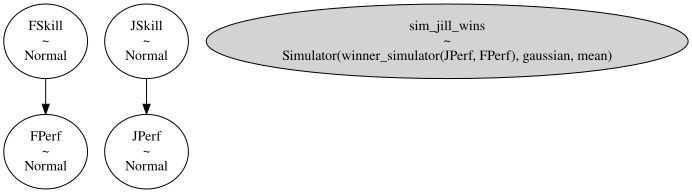

In [60]:
with model:
    trace, sim_data = pm.sample_smc(draws=5000, tune_steps=1000, kernel="ABC", parallel=False, save_sim_data=True,  random_seed=3910101)
    idata = az.from_pymc3(trace, posterior_predictive=sim_data)
pm.model_to_graphviz(model)

In [61]:
sim_data['sim_jill_wins'].mean() # great

0.0

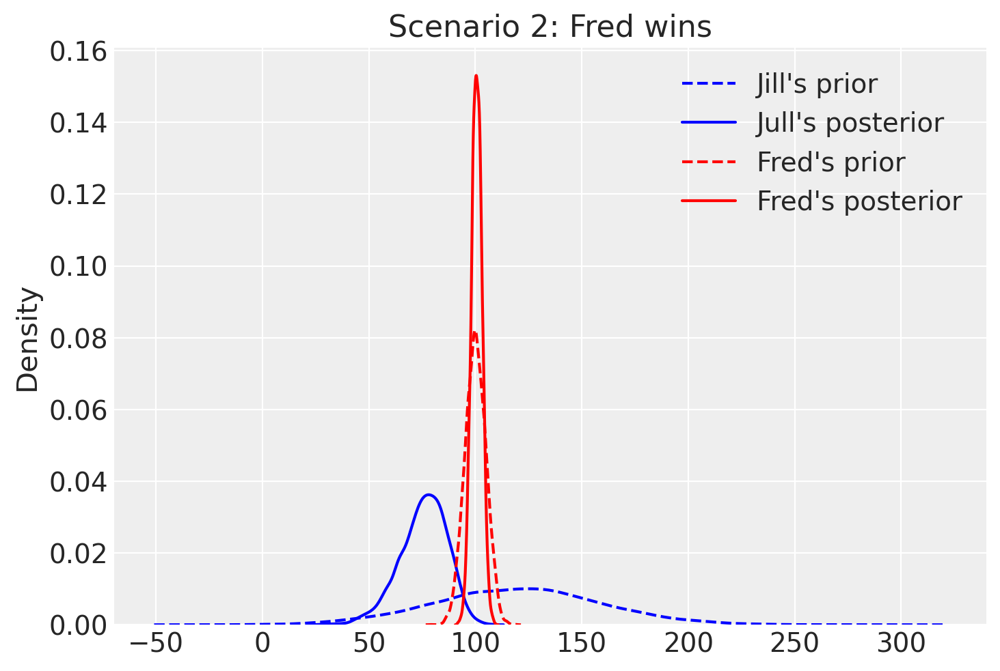

In [62]:
sns.kdeplot(sim_prior['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(idata.posterior['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(sim_prior['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(idata.posterior['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

_ = plt.legend()
_ = plt.title('Scenario 2: Fred wins')

The posterior is much sharper now.

In [63]:
idata.posterior['JSkill'].mean()

<xarray.DataArray 'JSkill' ()>
array(75.57979998)

In [64]:
idata.posterior['FSkill'].mean()

<xarray.DataArray 'FSkill' ()>
array(100.66587688)

## [4. Extending the core model](https://mbmlbook.com/TrueSkill_Extensions_to_the_core_model.html)

    "So far, we have constructed a probabilistic model of a game played between two players which results in a win for one of the players. To handle the variety of games needed by Xbox Live, we need to extend our model to deal with a number of additional complexities. In particular, real games can end in draws, can involve more than two players, and can be played between teams of people. We will now show how our initial model can be extended to take account of these complexities. This flexibility nicely illustrates the power of a model-based approach to machine learning."

### Extension: Allowing for draws

    Modified assumption 3: 

    The player with the higher performance value wins the game, unless the difference between their performance and that of their opponent is less than the draw margin, in which case the game is drawn. 

#### Let's try to build likelhiood function again

In [65]:
GAME_OUTCOME = [1, 0, 0]

In [66]:
pm.math.minimum(0, 10).eval()

array(0, dtype=int8)

In [67]:
pm.math.stack([1, 1, 1]).eval()

array([1, 1, 1], dtype=int8)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Sequential sampling (2 chains in 1 job)
NUTS: [FPerf, JPerf, FSkill, JSkill, draw_margin]


Sampling 2 chains for 5_000 tune and 10_000 draw iterations (10_000 + 20_000 draws total) took 33 seconds.
There were 5233 divergences after tuning. Increase `target_accept` or reparameterize.
There were 10397 divergences after tuning. Increase `target_accept` or reparameterize.
The number of effective samples is smaller than 10% for some parameters.


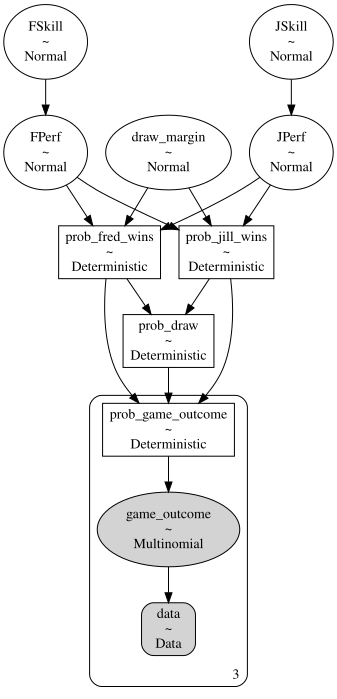

In [68]:
with pm.Model() as model:
    
    data = pm.Data('data', GAME_OUTCOME)
    draw_margin = pm.Normal('draw_margin', mu=1, sigma=10)
    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
    
    prob_jill_wins = pm.Deterministic('prob_jill_wins', pm.math.invlogit(JPerf - FPerf - draw_margin))
    prob_fred_wins = pm.Deterministic('prob_fred_wins', pm.math.invlogit(FPerf - JPerf - draw_margin))
    prob_draw = pm.Deterministic('prob_draw', pm.math.minimum(1 - prob_jill_wins - prob_fred_wins, 0))
    prob_game_outcome = pm.Deterministic('prob_game_outcome', pm.math.stack([prob_jill_wins, prob_fred_wins, prob_draw]))
    
    game_outcome = pm.Multinomial("game_outcome", n=1, p=prob_game_outcome, observed=data)

    trace = pm.sample(10000, tune=5000, return_inferencedata=True, random_seed=3910101, cores=1)
pm.model_to_graphviz(model)

/Users/amosin/opt/anaconda3/envs/pymc3_env/lib/python3.9/site-packages/arviz/stats/density_utils.py:481: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")
/Users/amosin/opt/anaconda3/envs/pymc3_env/lib/python3.9/site-packages/arviz/stats/density_utils.py:481: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")
/Users/amosin/opt/anaconda3/envs/pymc3_env/lib/python3.9/site-packages/arviz/stats/density_utils.py:481: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")
/Users/amosin/opt/anaconda3/envs/pymc3_env/lib/python3.9/site-packages/arviz/stats/density_utils.py:481: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a

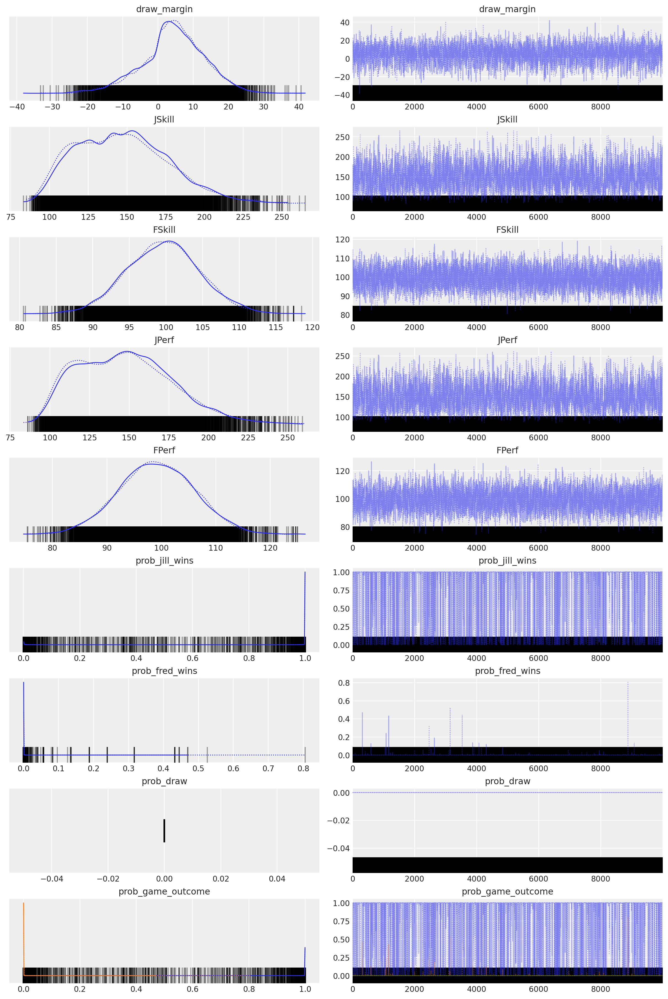

In [69]:
az.plot_trace(trace);

Looks horrible.

https://discourse.pymc.io/t/trueskill-model-setup/2585

https://discourse.pymc.io/t/trueskill-model-setup/2585

#### Cumulative Gaussian

https://discourse.pymc.io/t/how-to-model-a-deterministic-greater-than/3471/6

https://discourse.mc-stan.org/t/implementing-a-factor-graph-model-for-the-trueskill-algorithm/7810

In [70]:
GAME_OUTCOME = np.array([[1, 0, 0],
                         [0, 1, 0],
                         [0, 0, 1]])
GAME_OUTCOME = [1, 0, 0]

WARNING (theano.tensor.opt): Optimization Warning: The Op erfcx does not provide a C implementation. As well as being potentially slow, this also disables loop fusion.
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [FSkill, JSkill, draw_margin]


Sampling 4 chains for 5_000 tune and 10_000 draw iterations (20_000 + 40_000 draws total) took 27 seconds.
There were 6096 divergences after tuning. Increase `target_accept` or reparameterize.
There were 6280 divergences after tuning. Increase `target_accept` or reparameterize.
There were 6554 divergences after tuning. Increase `target_accept` or reparameterize.
There were 6175 divergences after tuning. Increase `target_accept` or reparameterize.
The number of effective samples is smaller than 25% for some parameters.


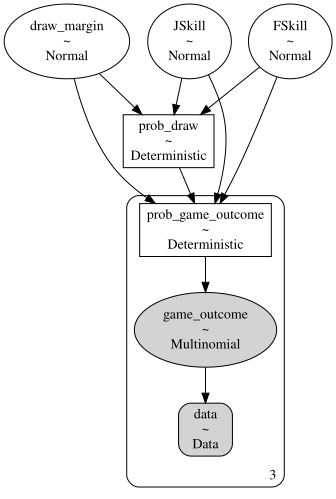

In [71]:
with pm.Model() as model:
    
    data = pm.Data('data', GAME_OUTCOME)
    draw_margin = pm.Normal('draw_margin', mu=1, sigma=10)
    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    

    prob_jill_wins = pm.math.exp(pm.distributions.dist_math.normal_lccdf(JSkill - FSkill - draw_margin, pm.math.sqrt(5**2 + 5**2 + 10**2), 0.))
    prob_fred_wins = pm.math.exp(pm.distributions.dist_math.normal_lccdf(FSkill - JSkill - draw_margin, pm.math.sqrt(5**2 + 5**2 + 10**2), 0.))        
    prob_draw = pm.Deterministic('prob_draw', pm.math.minimum(1 - prob_jill_wins - prob_fred_wins, 0))
    prob_game_outcome = pm.Deterministic('prob_game_outcome', pm.math.stack([prob_jill_wins, prob_fred_wins, prob_draw]))
    
    game_outcome = pm.Multinomial("game_outcome", n=1, p=prob_game_outcome, observed=data)

    trace = pm.sample(10000, tune=5000, return_inferencedata=True, random_seed=3910101)
pm.model_to_graphviz(model)

/Users/amosin/opt/anaconda3/envs/pymc3_env/lib/python3.9/site-packages/arviz/stats/density_utils.py:481: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")
/Users/amosin/opt/anaconda3/envs/pymc3_env/lib/python3.9/site-packages/arviz/stats/density_utils.py:481: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")
/Users/amosin/opt/anaconda3/envs/pymc3_env/lib/python3.9/site-packages/arviz/stats/density_utils.py:481: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")
/Users/amosin/opt/anaconda3/envs/pymc3_env/lib/python3.9/site-packages/arviz/stats/density_utils.py:481: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a

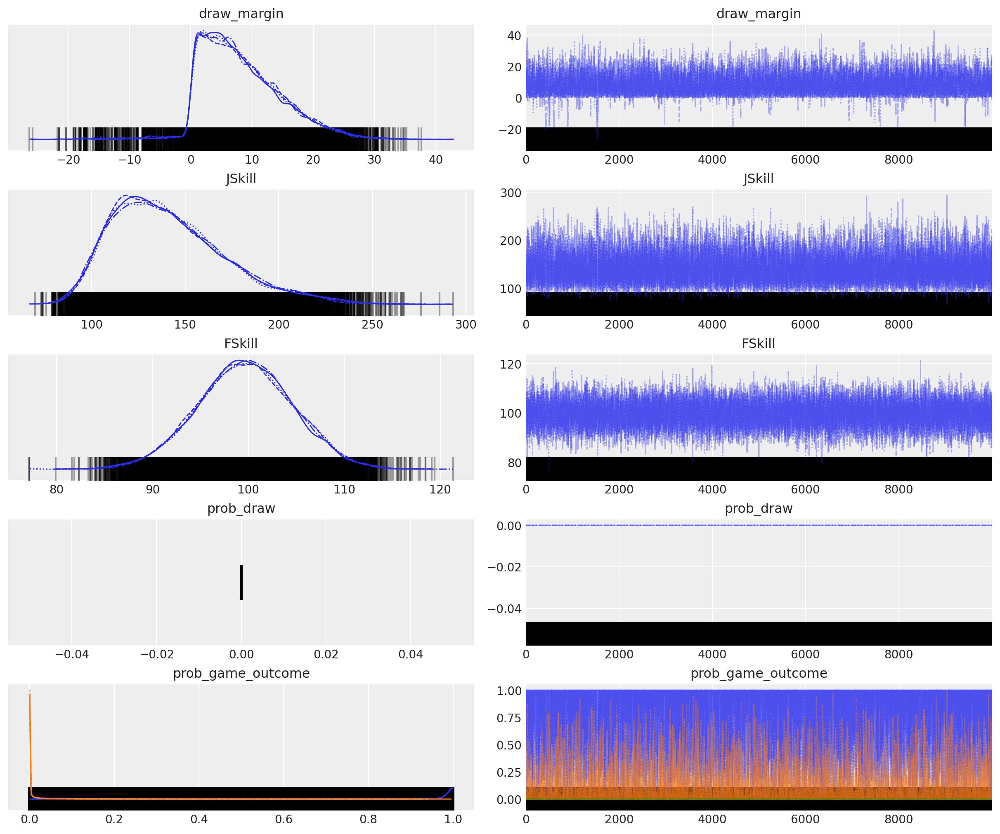

In [72]:
az.plot_trace(trace);

Does not trustworthy either, we predict only 84% of Jill's wins

In [73]:
trace.posterior.prob_game_outcome.mean(axis=0).mean(axis=0)

<xarray.DataArray 'prob_game_outcome' (prob_game_outcome_dim_0: 3)>
array([0.84407231, 0.03936075, 0.        ])
Coordinates:
  * prob_game_outcome_dim_0  (prob_game_outcome_dim_0) int64 0 1 2

In [74]:
trace.posterior.keys()

KeysView(<xarray.Dataset>
Dimensions:                  (chain: 4, draw: 10000, prob_game_outcome_dim_0: 3)
Coordinates:
  * chain                    (chain) int64 0 1 2 3
  * draw                     (draw) int64 0 1 2 3 4 ... 9995 9996 9997 9998 9999
  * prob_game_outcome_dim_0  (prob_game_outcome_dim_0) int64 0 1 2
Data variables:
    draw_margin              (chain, draw) float64 6.566 3.657 ... 2.855 4.029
    JSkill                   (chain, draw) float64 122.2 133.2 ... 125.6 125.0
    FSkill                   (chain, draw) float64 95.15 94.87 ... 97.2 103.2
    prob_draw                (chain, draw) float64 0.0 0.0 0.0 ... 0.0 0.0 0.0
    prob_game_outcome        (chain, draw, prob_game_outcome_dim_0) float64 0...
Attributes:
    created_at:                 2022-09-24T10:47:15.883179
    arviz_version:              0.11.4
    inference_library:          pymc3
    inference_library_version:  3.11.4
    sampling_time:              27.09583592414856
    tuning_steps:               

### Try the ABC again

In [75]:
def winner_simulator(JPerf: float, FPerf: float, draw_margin: float):
    if JPerf - FPerf - draw_margin > 0:
        return np.array([1, 0, 0])
    elif FPerf - JPerf - draw_margin > 0:
        return np.array([0, 1, 0])
    else:
        return np.array([0, 0, 1])

In [76]:
GAME_OUTCOME 

[1, 0, 0]

Initializing SMC sampler...
Sampling 4 chains in 4 jobs
Stage:   0 Beta: 1.000
Stage:   0 Beta: 1.000
Stage:   0 Beta: 1.000
Stage:   0 Beta: 1.000


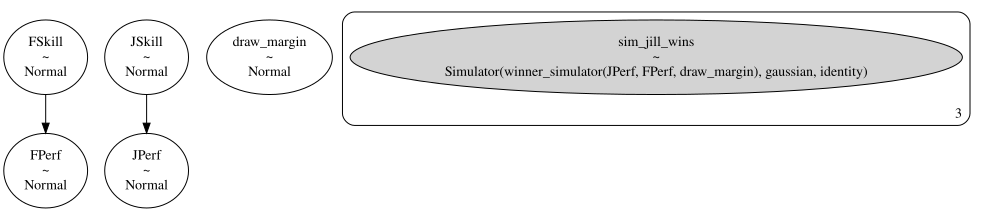

In [77]:
with pm.Model() as model:

    draw_margin = pm.Normal('draw_margin', mu=1, sigma=10)

    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
 
    sim_jill_wins = pm.Simulator('sim_jill_wins',
                                 winner_simulator,
                                 params=[JPerf, FPerf, draw_margin],
                                 observed=np.array(GAME_OUTCOME),
                                 epsilon=0.1
                                )
    
    trace, sim_data = pm.sample_smc(draws=5000, tune_steps=1000, kernel="ABC", parallel=False, save_sim_data=True,  random_seed=3910101)
    idata = az.from_pymc3(trace, posterior_predictive=sim_data)
pm.model_to_graphviz(model)

In [78]:
sim_data['sim_jill_wins'].mean(axis=0).mean(axis=0)

array([1., 0., 0.])

Got error No model on context stack. trying to find log_likelihood in translation.
/Users/amosin/opt/anaconda3/envs/pymc3_env/lib/python3.9/site-packages/arviz/data/io_pymc3_3x.py:98: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  warnings.warn(
Got error No model on context stack. trying to find log_likelihood in translation.


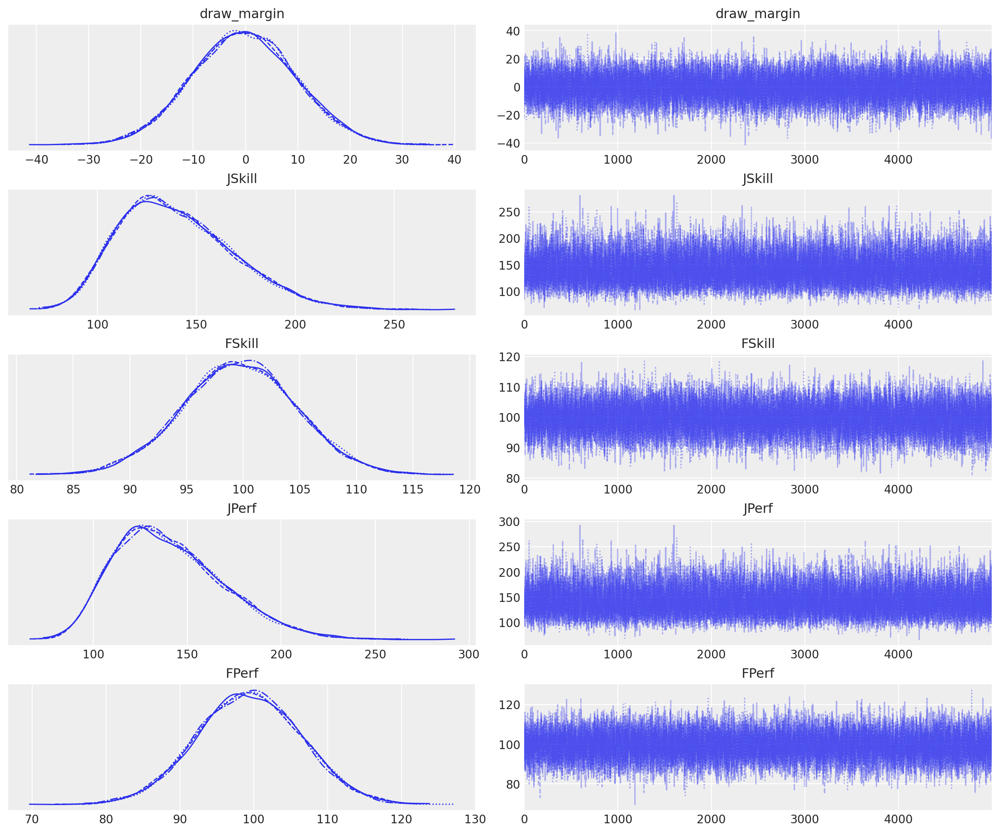

In [79]:
az.plot_trace(trace);

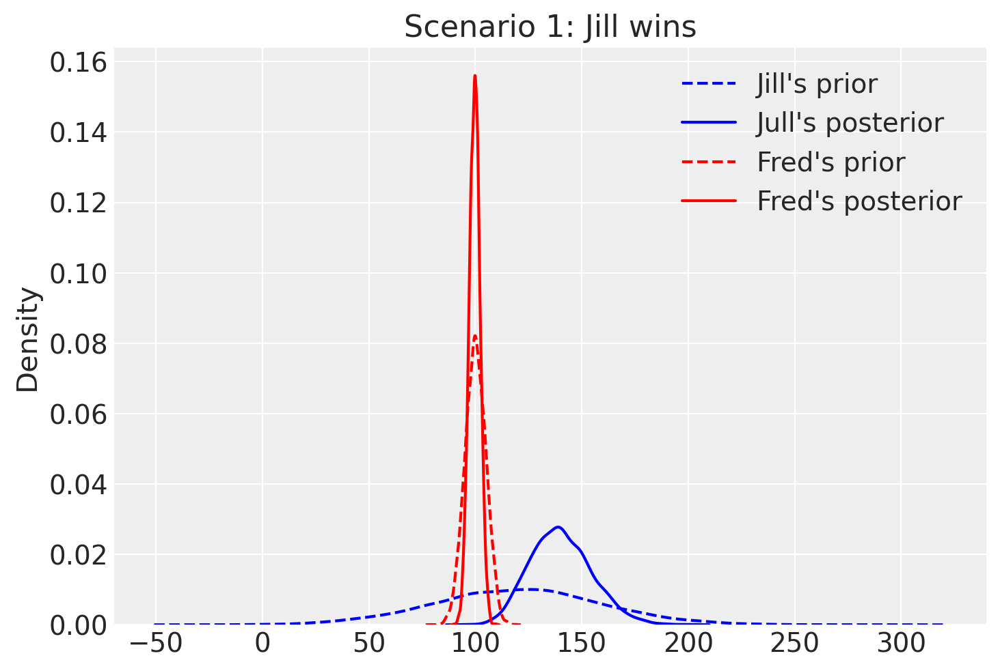

In [80]:
sns.kdeplot(sim_prior['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(idata.posterior['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(sim_prior['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(idata.posterior['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

_ = plt.legend()
_ = plt.title('Scenario 1: Jill wins')

In [81]:
idata.posterior['JSkill'].mean()

<xarray.DataArray 'JSkill' ()>
array(140.29134069)

In [82]:
idata.posterior['FSkill'].mean()

<xarray.DataArray 'FSkill' ()>
array(99.67667848)

In [83]:
GAME_OUTCOME = np.array([0, 1, 0])

Initializing SMC sampler...
Sampling 4 chains in 4 jobs
Stage:   0 Beta: 0.019
Stage:   1 Beta: 1.000
Stage:   0 Beta: 0.019
Stage:   1 Beta: 1.000
Stage:   0 Beta: 0.019
Stage:   1 Beta: 1.000
Stage:   0 Beta: 0.019
Stage:   1 Beta: 1.000


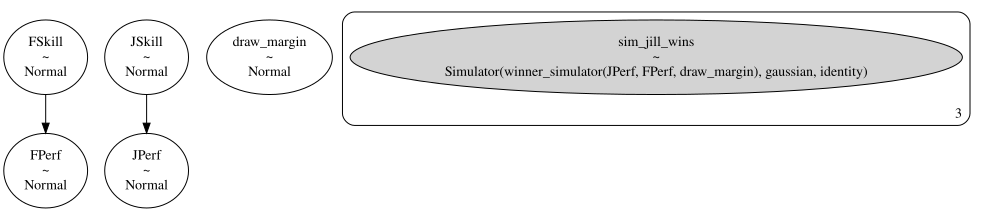

In [84]:
with pm.Model() as model:
    
    draw_margin = pm.Normal('draw_margin', mu=1, sigma=10)

    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
 
    sim_jill_wins = pm.Simulator('sim_jill_wins',
                                 winner_simulator,
                                 params=[JPerf, FPerf, draw_margin], 
                                 observed=np.array(GAME_OUTCOME),
                                 epsilon=.1
                                )
    
    trace, sim_data = pm.sample_smc(draws=5000, tune_steps=1000, kernel="ABC", parallel=False, save_sim_data=True, random_seed=3910101)
    idata = az.from_pymc3(trace, posterior_predictive=sim_data)
pm.model_to_graphviz(model)

In [85]:
sim_data['sim_jill_wins'].mean(axis=0).mean(axis=0)

array([0., 1., 0.])

Got error No model on context stack. trying to find log_likelihood in translation.
/Users/amosin/opt/anaconda3/envs/pymc3_env/lib/python3.9/site-packages/arviz/data/io_pymc3_3x.py:98: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  warnings.warn(
Got error No model on context stack. trying to find log_likelihood in translation.


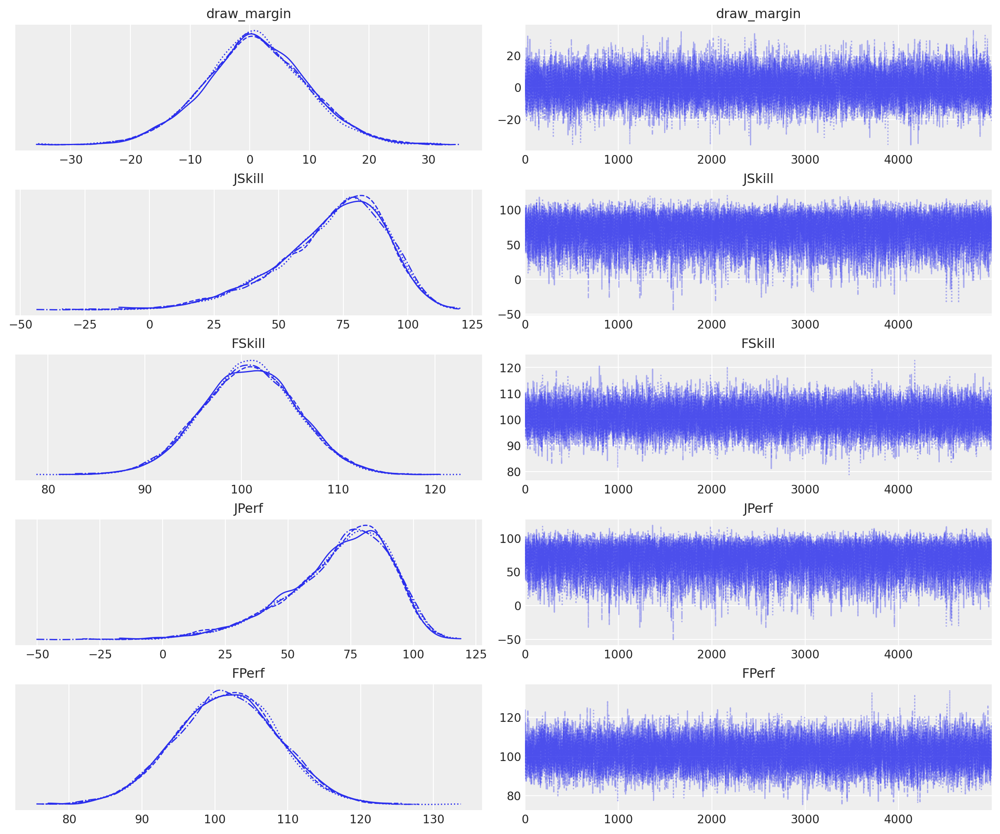

In [86]:
az.plot_trace(trace);

Jill's skills is reduced but the % of time she wins is still substantial. Try reducing the $\epsilon$ value

In [87]:
sim_data['sim_jill_wins'].mean(axis=0).mean(axis=0)

array([0., 1., 0.])

In [88]:
idata.posterior['JSkill'].mean(axis=1)

<xarray.DataArray 'JSkill' (chain: 4)>
array([70.47481801, 71.33847714, 70.8375146 , 71.10289738])
Coordinates:
  * chain    (chain) int64 0 1 2 3

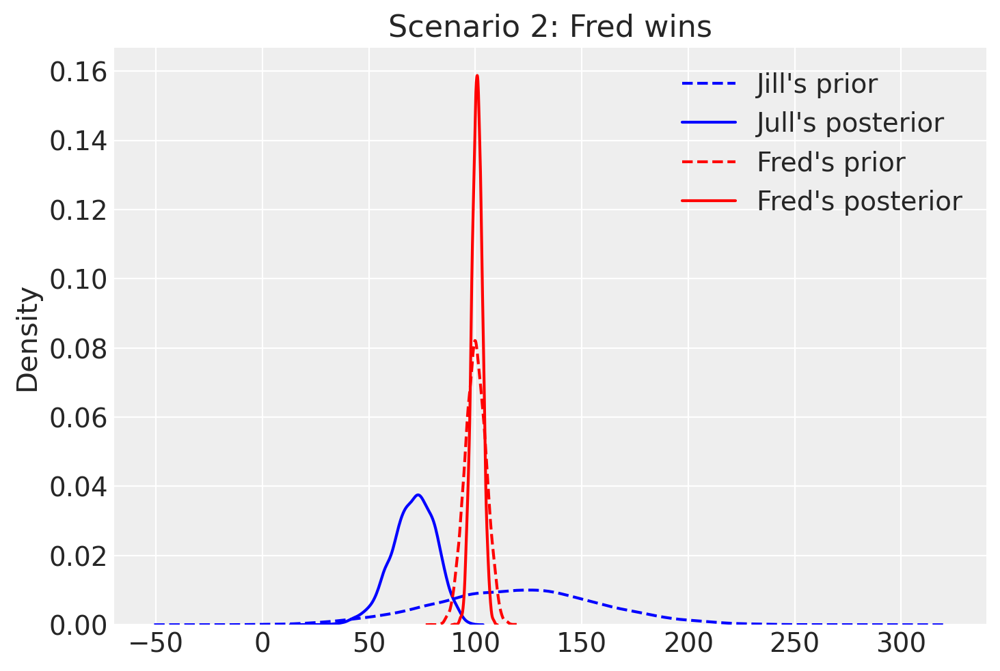

In [89]:
sns.kdeplot(sim_prior['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(idata.posterior['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(sim_prior['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(idata.posterior['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

_ = plt.legend()
_ = plt.title('Scenario 2: Fred wins')

In [90]:
GAME_OUTCOME = np.array([0, 0, 1]) # draw

I'd expect Jill's skill to match the Fred's skill now

Initializing SMC sampler...
Sampling 4 chains in 4 jobs
Stage:   0 Beta: 0.018
Stage:   1 Beta: 0.040
Stage:   2 Beta: 1.000
Stage:   0 Beta: 0.019
Stage:   1 Beta: 0.040
Stage:   2 Beta: 1.000
Stage:   0 Beta: 0.018
Stage:   1 Beta: 0.040
Stage:   2 Beta: 1.000
Stage:   0 Beta: 0.018
Stage:   1 Beta: 0.040
Stage:   2 Beta: 1.000


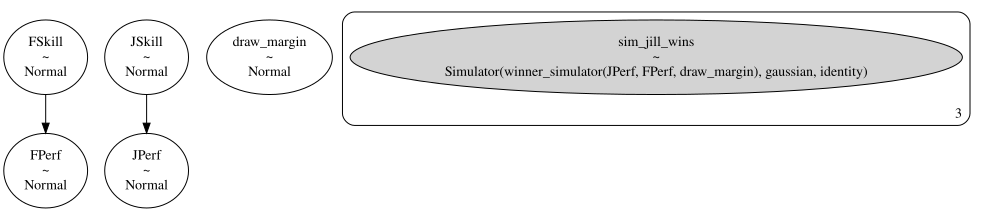

In [91]:
with pm.Model() as model:
    
    draw_margin = pm.Normal('draw_margin', mu=1, sigma=10)

    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
 
    sim_jill_wins = pm.Simulator('sim_jill_wins',
                                 winner_simulator,
                                 params=[JPerf, FPerf, draw_margin], 
                                 observed=np.array(GAME_OUTCOME),
                                 epsilon=.1
                                )
    
    trace, sim_data = pm.sample_smc(draws=5000, tune_steps=1000, kernel="ABC", parallel=False, save_sim_data=True, random_seed=3910101)
    idata = az.from_pymc3(trace, posterior_predictive=sim_data)
pm.model_to_graphviz(model)

In [92]:
# this should be close the the observed [0, 0, 1]
sim_data['sim_jill_wins'].mean(axis=0).mean(axis=0)

array([0., 0., 1.])

Got error No model on context stack. trying to find log_likelihood in translation.
/Users/amosin/opt/anaconda3/envs/pymc3_env/lib/python3.9/site-packages/arviz/data/io_pymc3_3x.py:98: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  warnings.warn(
Got error No model on context stack. trying to find log_likelihood in translation.


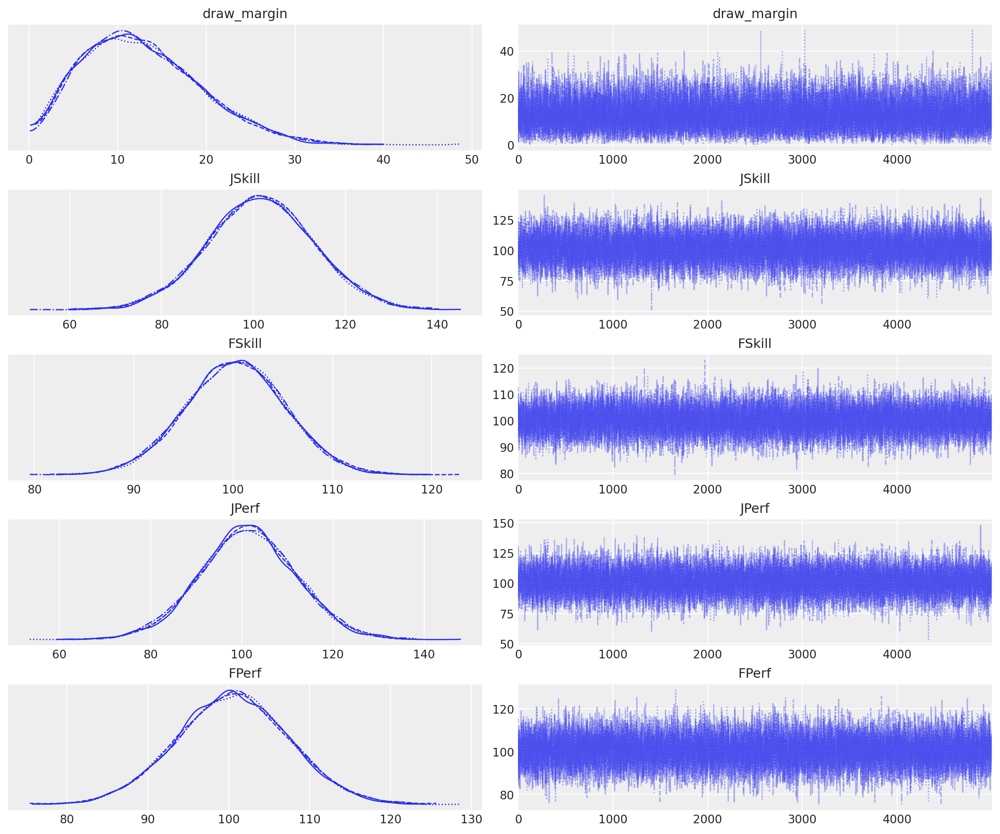

In [93]:
az.plot_trace(trace);

Great, Jill's skill is on par with Fred's, as expected

In [94]:
idata.posterior['JSkill'].mean(axis=1)

<xarray.DataArray 'JSkill' (chain: 4)>
array([101.63163695, 101.61466506, 101.69942538, 101.55071641])
Coordinates:
  * chain    (chain) int64 0 1 2 3

In [95]:
idata.posterior['FSkill'].mean(axis=1)

<xarray.DataArray 'FSkill' (chain: 4)>
array([100.19491367, 100.2499915 , 100.26986139, 100.22070703])
Coordinates:
  * chain    (chain) int64 0 1 2 3

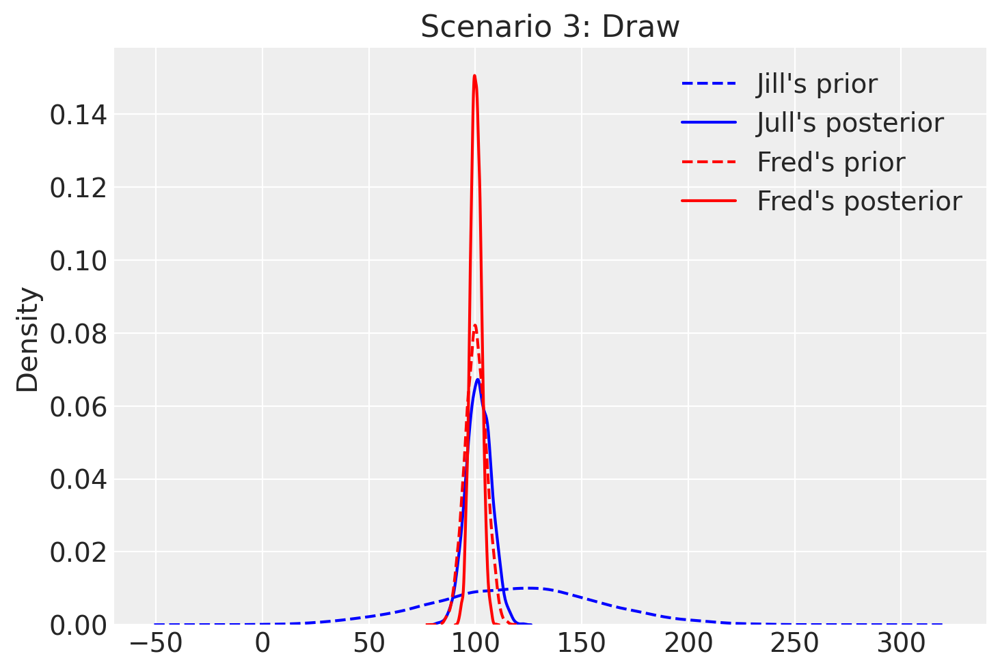

In [96]:
sns.kdeplot(sim_prior['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(idata.posterior['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(sim_prior['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(idata.posterior['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

_ = plt.legend()
_ = plt.title('Scenario 3: Draw')

## Extension: Having more than 2 players.

Assumption 3: The order of players in the game outcome is the same as the ordering of their performance values in that game. 

In [97]:
from typing import Iterable
def winner_simulator(player_performances: Iterable[float]) -> Iterable[int]:
    """Rank players according to their performance values"""
    pass

In [98]:
p_perf = np.array([102, 97, 150])
p_names = np.array(['Jill', 'Fred', 'Steve'])

In [99]:
p_rank = p_perf.argsort()
p_rank

array([1, 0, 2])

In [100]:
p_perf[p_rank]

array([ 97, 102, 150])

In [101]:
p_names[p_rank]

array(['Fred', 'Jill', 'Steve'], dtype='<U5')

In [102]:
from typing import Iterable
def winner_simulator(player_performances: Iterable[float]) -> Iterable[int]:
    """Rank players according to their performance values"""
    return player_performances.argsort()

    Back in Figure 3.29 and Figure 3.30, we saw that the shift of the distributions between prior and posterior were larger in the case where the weaker player (Fred) won the game. Now we repeat the experiment, except with a third player (Steve), whose prior skill distribution is Gaussian(140,402), keeping Jill as Gaussian(120,402) and Fred as Gaussian(100,52) as before. We apply our multi-player TrueSkill model to a game with the outcome Jill 1st, Fred 2nd, Steve 3rd. 

In [103]:
GAME_OUTCOME = np.array([2, 1, 0])

In [104]:
pm.math.stack([0, 1]).eval()

array([0, 1], dtype=int8)

Not sure if similarity measure based on MSE is appropriate here. If it fails, can try https://en.wikipedia.org/wiki/Kendall_tau_distance

Initializing SMC sampler...
Sampling 4 chains in 4 jobs
Stage:   0 Beta: 0.007
Stage:   1 Beta: 0.026
Stage:   2 Beta: 1.000
Stage:   0 Beta: 0.007
Stage:   1 Beta: 0.026
Stage:   2 Beta: 1.000
Stage:   0 Beta: 0.007
Stage:   1 Beta: 0.025
Stage:   2 Beta: 1.000
Stage:   0 Beta: 0.007
Stage:   1 Beta: 0.025
Stage:   2 Beta: 1.000


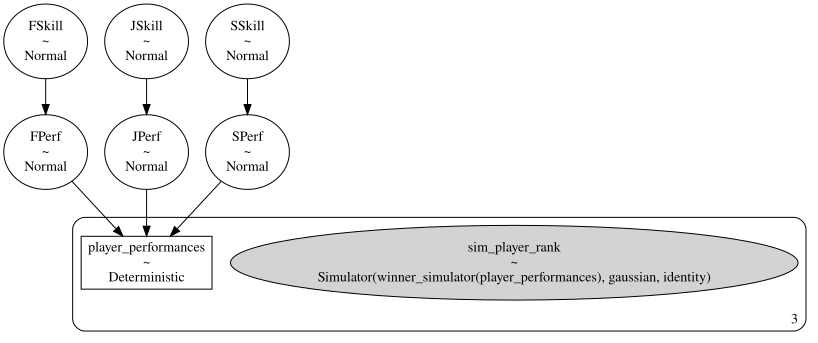

In [105]:
with pm.Model() as model:
    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    SSKill = pm.Normal("SSkill", mu=140, sigma=40)  #  Steve, a new player
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
    SPerf = pm.Normal("SPerf", mu=SSKill, sigma=5)
    
    player_performances = pm.Deterministic('player_performances', pm.math.stack([JPerf, FPerf, SPerf]))
 
    sim_player_rank = pm.Simulator('sim_player_rank',
                                   winner_simulator,
                                   params=[player_performances],
                                   observed=np.array(GAME_OUTCOME),
                                   epsilon=.1
                                )
    
    trace, sim_data = pm.sample_smc(draws=5000, tune_steps=1000, kernel="ABC", parallel=False, save_sim_data=True, random_seed=3910101)
    idata = az.from_pymc3(trace, posterior_predictive=sim_data)
pm.model_to_graphviz(model)

In [106]:
sim_data.keys()

dict_keys(['sim_player_rank'])

In [107]:
sim_data['sim_player_rank'].mean(axis=0).mean(axis=0)

array([2., 1., 0.])

In [108]:
GAME_OUTCOME

array([2, 1, 0])

OK, it manages to predict the data correctly.

Got error No model on context stack. trying to find log_likelihood in translation.
/Users/amosin/opt/anaconda3/envs/pymc3_env/lib/python3.9/site-packages/arviz/data/io_pymc3_3x.py:98: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  warnings.warn(
Got error No model on context stack. trying to find log_likelihood in translation.


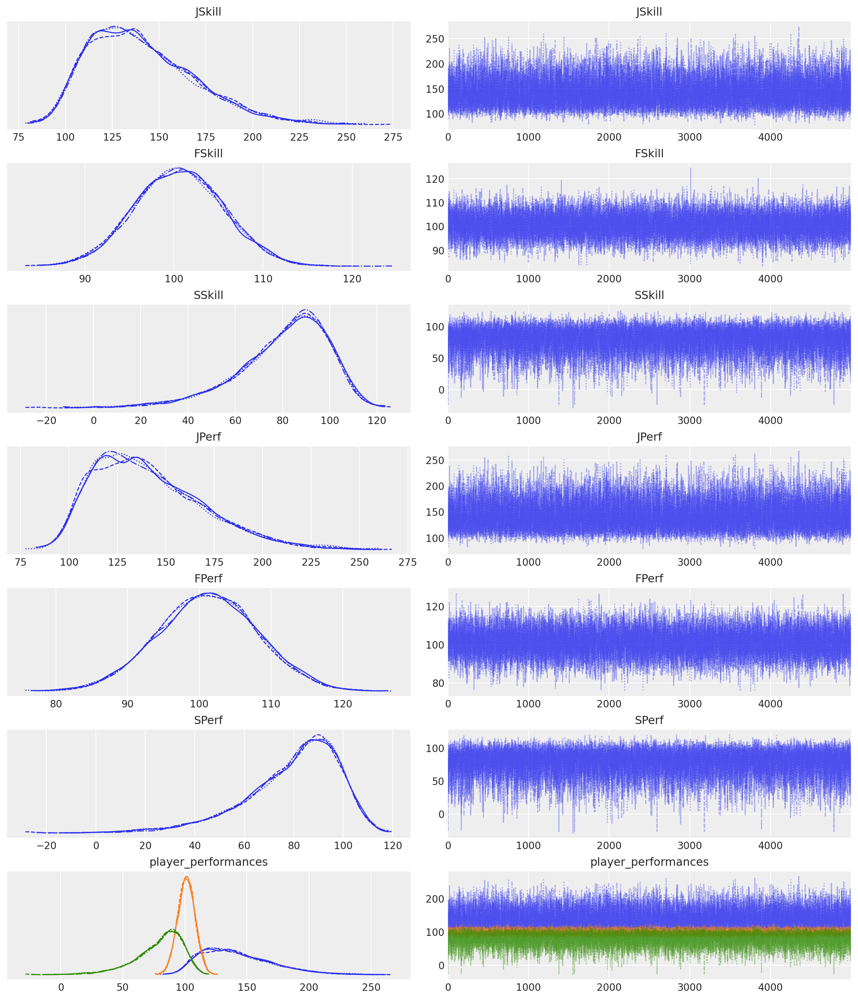

In [109]:
az.plot_trace(trace);

In [110]:
prior_perf = pm.sample_prior_predictive(samples=1000, model=model)

In [111]:
prior_perf.keys()

dict_keys(['SPerf', 'sim_player_rank', 'player_performances', 'FPerf', 'JPerf', 'FSkill', 'SSkill', 'JSkill'])

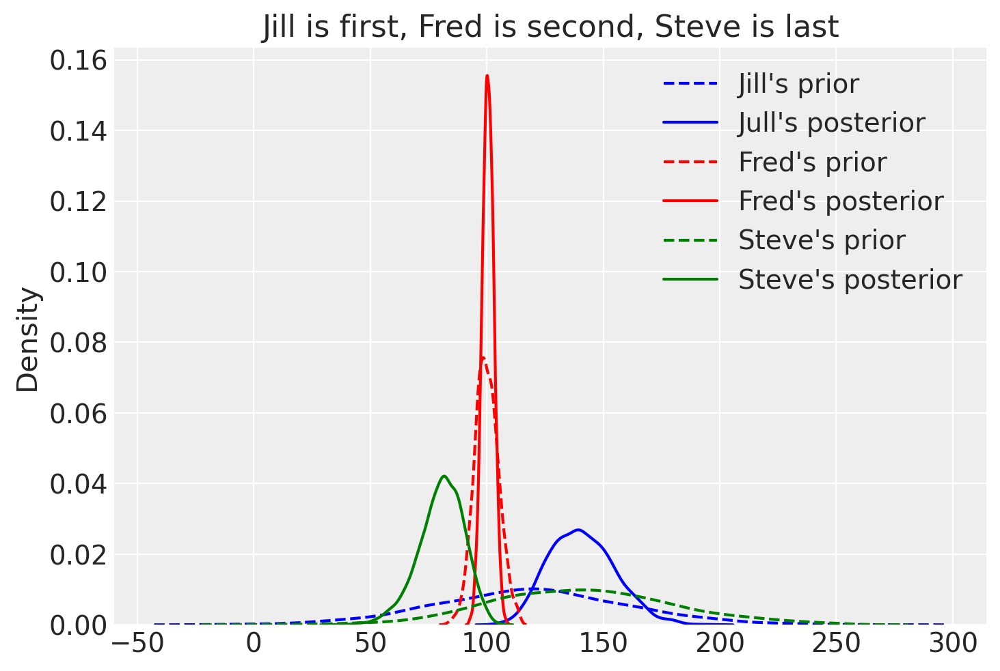

In [112]:
sns.kdeplot(prior_perf['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(idata.posterior['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(prior_perf['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(idata.posterior['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

sns.kdeplot(prior_perf['SSkill'], label="Steve's prior", ls='--', color='green')
sns.kdeplot(pd.Series(idata.posterior['SSkill'].mean(axis=0)), label="Steve's posterior", color='green')



_ = plt.legend()
_ = plt.title('Jill is first, Fred is second, Steve is last')

In [113]:
idata.posterior['JSkill'].mean()

<xarray.DataArray 'JSkill' ()>
array(140.9708914)

In [114]:
idata.posterior['FSkill'].mean()

<xarray.DataArray 'FSkill' ()>
array(100.55497805)

In [115]:
idata.posterior['SSkill'].mean()

<xarray.DataArray 'SSkill' ()>
array(80.41596165)

Looks similar to Figure 3.35

    " Firstly, note that since Steve was expected to be the strongest player, but in fact came last, his posterior mean has moved markedly downwards (to below the other two players). Secondly, note that the changes in the means of Jill and Fred are in the same direction as in Figure 3.29, but are more pronounced than before. This again is because the overall game result is more surprising."

In [116]:
GAME_OUTCOME

array([2, 1, 0])

In [117]:
p_names

array(['Jill', 'Fred', 'Steve'], dtype='<U5')

In [118]:
GAME_OUTCOME

array([2, 1, 0])

### Another scenario

In [119]:
GAME_OUTCOME = np.array([1, 2, 0]) # Fred is the winner, followed by Jill and Steve

Initializing SMC sampler...
Sampling 4 chains in 4 jobs
Stage:   0 Beta: 0.006
Stage:   1 Beta: 1.000
Stage:   0 Beta: 0.006
Stage:   1 Beta: 1.000
Stage:   0 Beta: 0.006
Stage:   1 Beta: 1.000
Stage:   0 Beta: 0.006
Stage:   1 Beta: 1.000


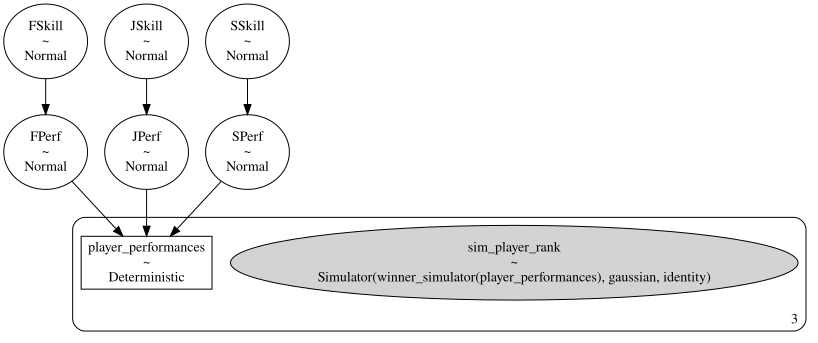

In [120]:
with pm.Model() as model:
    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    SSKill = pm.Normal("SSkill", mu=140, sigma=40)  #  Steve, a new player
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
    SPerf = pm.Normal("SPerf", mu=SSKill, sigma=5)
    
    player_performances = pm.Deterministic('player_performances', pm.math.stack([JPerf, FPerf, SPerf]))
 
    sim_player_rank = pm.Simulator('sim_player_rank',
                                   winner_simulator,
                                   params=[player_performances],
                                   observed=np.array(GAME_OUTCOME),
                                   epsilon=.1
                                )
    
    trace, sim_data = pm.sample_smc(draws=5000, tune_steps=1000, kernel="ABC", parallel=False, save_sim_data=True, random_seed=3910101)
    idata = az.from_pymc3(trace, posterior_predictive=sim_data)
pm.model_to_graphviz(model)

In [121]:
sim_data['sim_player_rank'].mean(axis=0).mean(axis=0)

array([1., 2., 0.])

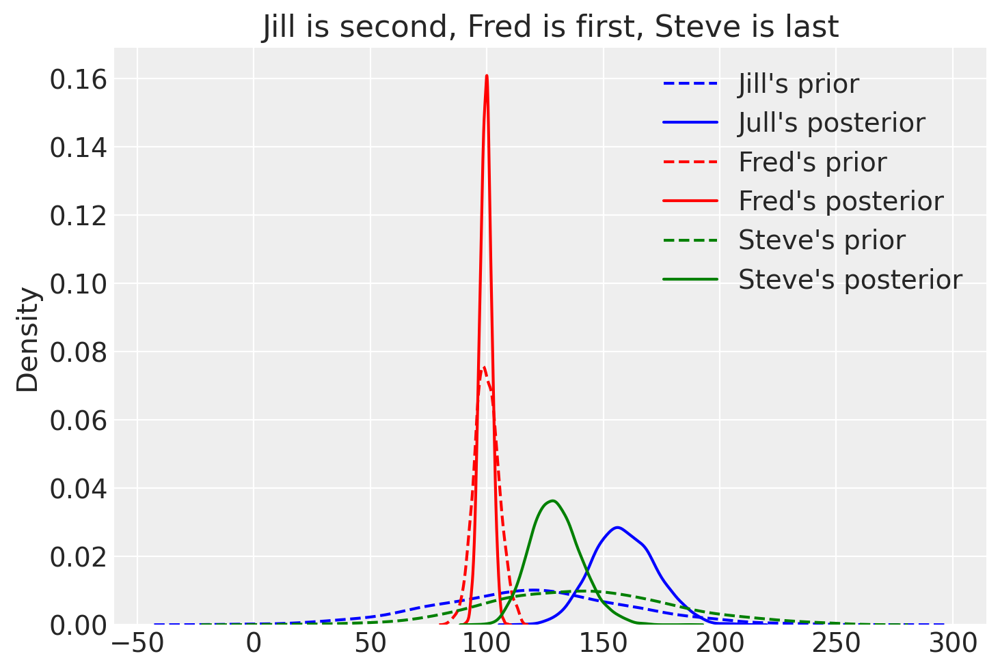

In [122]:
sns.kdeplot(prior_perf['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(idata.posterior['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(prior_perf['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(idata.posterior['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

sns.kdeplot(prior_perf['SSkill'], label="Steve's prior", ls='--', color='green')
sns.kdeplot(pd.Series(idata.posterior['SSkill'].mean(axis=0)), label="Steve's posterior", color='green')



_ = plt.legend()
_ = plt.title('Jill is second, Fred is first, Steve is last')

It failed here, as Steve's posterior did not move, despite the fact that he came in last. Let's try to use a proper measure for the ranked data


https://docs.scipy.org/doc/scipy-0.15.1/reference/generated/scipy.stats.kendalltau.html

https://en.wikipedia.org/wiki/Kendall_tau_distance#Computing_the_Kendall_tau_distance


https://en.wikipedia.org/wiki/Kendall_rank_correlation_coefficient

In [123]:
GAME_OUTCOME

array([1, 2, 0])

In [124]:
candidate = np.array([0, 1, 2])

In [125]:
st.kendalltau(GAME_OUTCOME, GAME_OUTCOME).correlation

1.0

In [126]:
st.kendalltau(GAME_OUTCOME, candidate).correlation 

-0.33333333333333337

In [127]:
def kendaltau(epsilon, obs_data, sim_data):
    return np.array([st.kendalltau(obs_data, sim_data).correlation])

In [128]:
x = np.linspace(-1, 1)

In [129]:
GAME_OUTCOME

array([1, 2, 0])

https://en.wikipedia.org/wiki/Kendall_tau_distance

In [130]:
def dist_kendaltau(epsilon, obs_data, sim_data):
    #https://en.wikipedia.org/wiki/Kendall_tau_distance
    corr = st.kendalltau(obs_data, sim_data).correlation
    n = len(obs_data)
    dist = (1 - corr) * n * (n - 1) / 4
    return np.array([dist / epsilon])

In [131]:
def dist_kendaltau_sim(corr, n):
    return (1 - corr) * n * (n - 1) / 4

Text(0, 0.5, 'Kendeal distance')

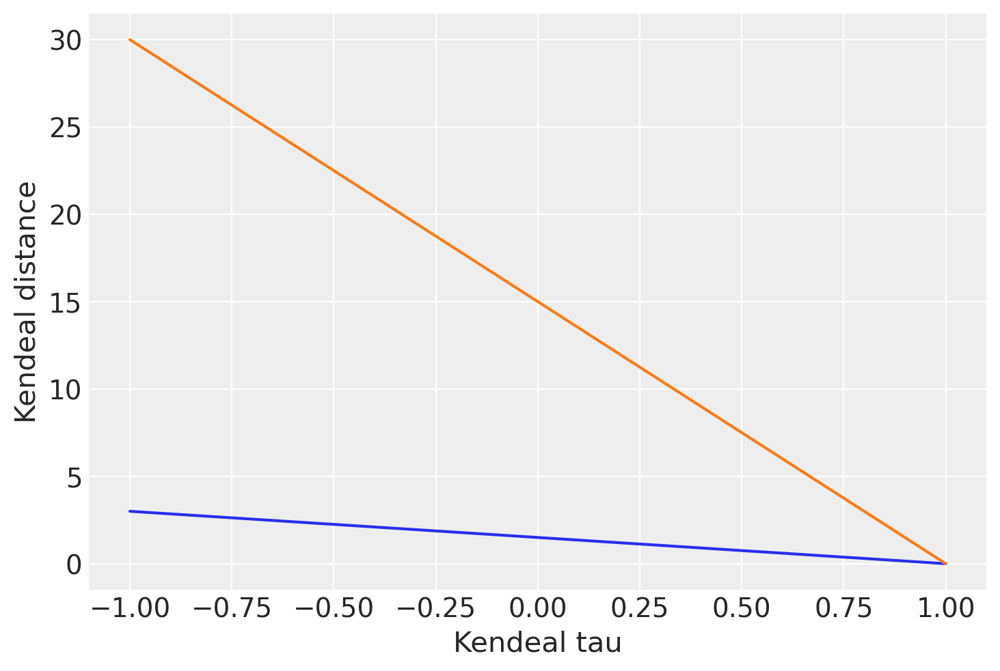

In [132]:
x = np.linspace(-1, 1)
pd.Series(dist_kendaltau_sim(x, n=3) / 1, index=x).plot(label='eps=1')
pd.Series(dist_kendaltau_sim(x, n=3) / .1, index=x).plot(label='eps=.1')
plt.xlabel('Kendeal tau')
plt.ylabel('Kendeal distance')

In [133]:
GAME_OUTCOME = np.array([2, 1, 0])

Initializing SMC sampler...
Sampling 4 chains in 4 jobs
Stage:   0 Beta: 0.133
Stage:   1 Beta: 1.000
Stage:   0 Beta: 0.132
Stage:   1 Beta: 1.000
Stage:   0 Beta: 0.134
Stage:   1 Beta: 1.000
Stage:   0 Beta: 0.134
Stage:   1 Beta: 1.000


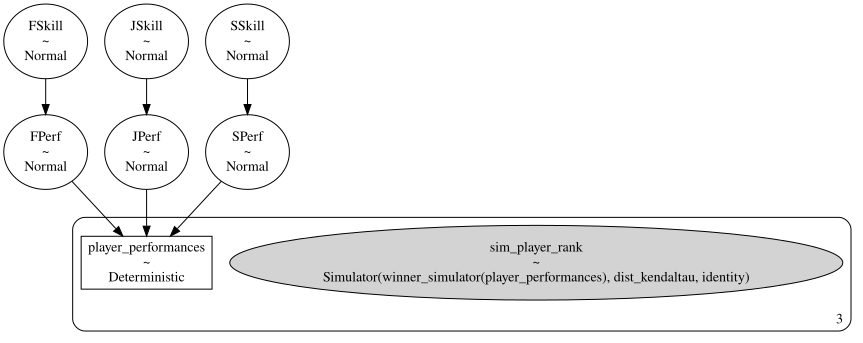

In [134]:
with pm.Model() as model:
    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    SSKill = pm.Normal("SSkill", mu=140, sigma=40)  #  Steve, a new player
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
    SPerf = pm.Normal("SPerf", mu=SSKill, sigma=5)
    
    player_performances = pm.Deterministic('player_performances', pm.math.stack([JPerf, FPerf, SPerf]))
 
    sim_player_rank = pm.Simulator('sim_player_rank',
                                   winner_simulator,
                                   params=[player_performances],
                                   sum_stat='identity',
                                   distance = dist_kendaltau,
                                   observed=np.array(GAME_OUTCOME),
                                   epsilon=.1
                                )
    
    trace, sim_data = pm.sample_smc(draws=5000, kernel="ABC", parallel=False, save_sim_data=True, random_seed=3910101)
    idata = az.from_pymc3(trace, posterior_predictive=sim_data)
pm.model_to_graphviz(model)

In [135]:
sim_data['sim_player_rank'].mean(axis=0).mean(axis=0)

array([5.0000e-05, 9.9995e-01, 2.0000e+00])

In [136]:
GAME_OUTCOME

array([2, 1, 0])

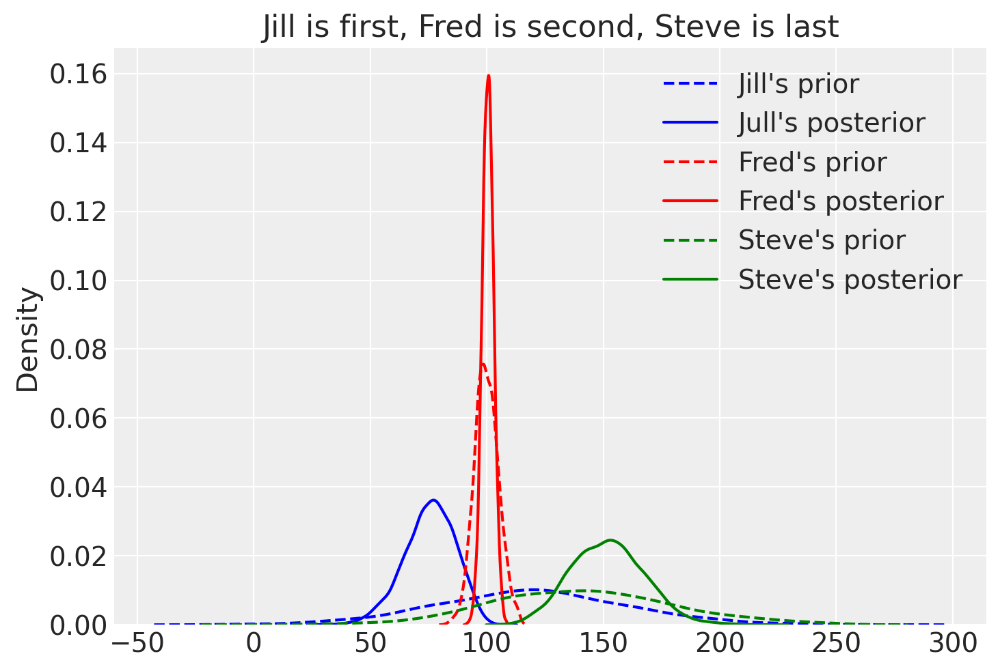

In [137]:
sns.kdeplot(prior_perf['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(idata.posterior['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(prior_perf['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(idata.posterior['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

sns.kdeplot(prior_perf['SSkill'], label="Steve's prior", ls='--', color='green')
sns.kdeplot(pd.Series(idata.posterior['SSkill'].mean(axis=0)), label="Steve's posterior", color='green')



_ = plt.legend()
_ = plt.title('Jill is first, Fred is second, Steve is last')

The documentation for Simulator is basically non-existant, so it's not clear whether they minimise or maximise the distance (logically, the lower the number, the better). Since I've gone that far, let's just reverse the sign

In [138]:
def dist_kendaltau(epsilon, obs_data, sim_data):
    #https://en.wikipedia.org/wiki/Kendall_tau_distance
    corr = st.kendalltau(obs_data, sim_data).correlation
    n = len(obs_data)
    dist = (1 - corr) * n * (n - 1) / 4
    return - np.array([dist / epsilon])

Initializing SMC sampler...
Sampling 4 chains in 4 jobs
Stage:   0 Beta: 0.095
Stage:   1 Beta: 0.289
Stage:   2 Beta: 1.000
Stage:   0 Beta: 0.095
Stage:   1 Beta: 0.287
Stage:   2 Beta: 1.000
Stage:   0 Beta: 0.095
Stage:   1 Beta: 0.288
Stage:   2 Beta: 1.000
Stage:   0 Beta: 0.094
Stage:   1 Beta: 0.288
Stage:   2 Beta: 1.000


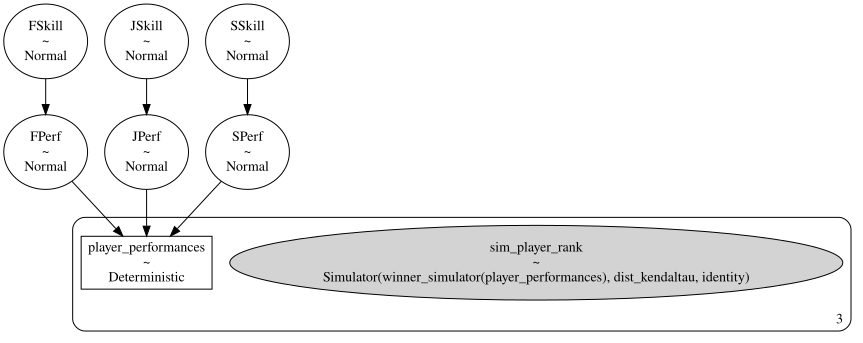

In [139]:
with pm.Model() as model:
    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    SSKill = pm.Normal("SSkill", mu=140, sigma=40)  #  Steve, a new player
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
    SPerf = pm.Normal("SPerf", mu=SSKill, sigma=5)
    
    player_performances = pm.Deterministic('player_performances', pm.math.stack([JPerf, FPerf, SPerf]))
 
    sim_player_rank = pm.Simulator('sim_player_rank',
                                   winner_simulator,
                                   params=[player_performances],
                                   sum_stat='identity',
                                   distance = dist_kendaltau,
                                   observed=np.array(GAME_OUTCOME),
                                   epsilon=.1
                                )
    
    trace, sim_data = pm.sample_smc(draws=5000, kernel="ABC", parallel=False, save_sim_data=True, random_seed=3910101)
    idata = az.from_pymc3(trace, posterior_predictive=sim_data)
pm.model_to_graphviz(model)

In [140]:
sim_data['sim_player_rank'].mean(axis=0).mean(axis=0)

array([1.99975, 1.00025, 0.     ])

In [141]:
GAME_OUTCOME

array([2, 1, 0])

Now the predictions match 

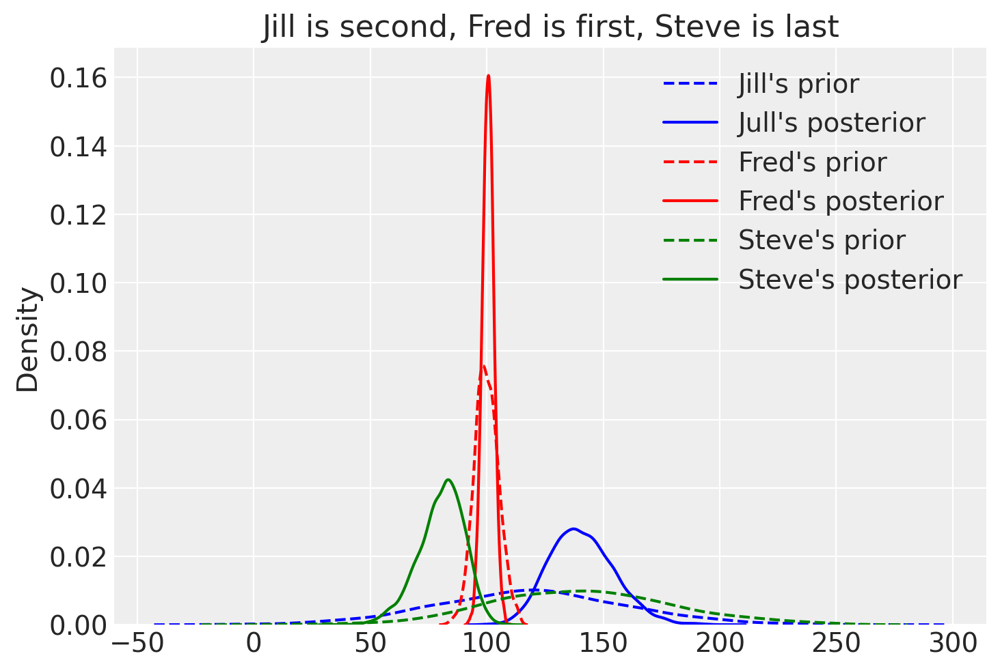

In [142]:
sns.kdeplot(prior_perf['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(idata.posterior['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(prior_perf['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(idata.posterior['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

sns.kdeplot(prior_perf['SSkill'], label="Steve's prior", ls='--', color='green')
sns.kdeplot(pd.Series(idata.posterior['SSkill'].mean(axis=0)), label="Steve's posterior", color='green')



_ = plt.legend()
_ = plt.title('Jill is second, Fred is first, Steve is last')

### Test another game outcome: Jill is the second, Steve is the last

In [143]:
GAME_OUTCOME = [1, 2, 0]

Initializing SMC sampler...
Sampling 4 chains in 4 jobs
Stage:   0 Beta: 0.088
Stage:   1 Beta: 1.000
Stage:   0 Beta: 0.087
Stage:   1 Beta: 1.000
Stage:   0 Beta: 0.086
Stage:   1 Beta: 1.000
Stage:   0 Beta: 0.087
Stage:   1 Beta: 1.000


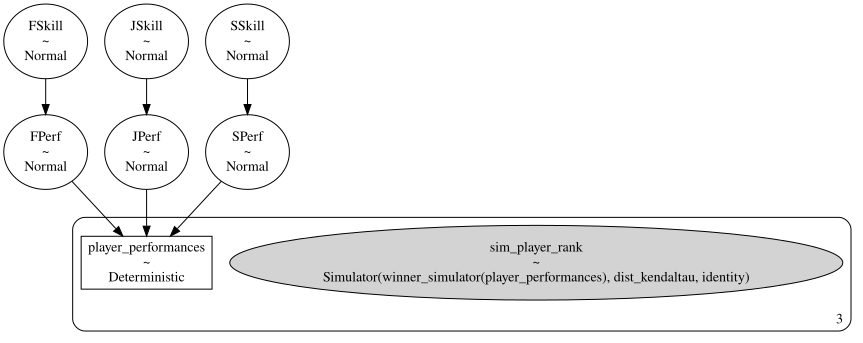

In [144]:
with pm.Model() as model:
    
    JSkill = pm.Normal("JSkill", mu=120, sigma=40) # skill level, high uncertainty because Jill is a new player
    FSkill = pm.Normal("FSkill", mu=100, sigma=5)  # lower uncertainty because Fred is an established player    
    SSKill = pm.Normal("SSkill", mu=140, sigma=40)  #  Steve, a new player
    
    JPerf = pm.Normal("JPerf", mu=JSkill, sigma=5) # mu=skill, performance in a particular game
    FPerf = pm.Normal("FPerf", mu=FSkill, sigma=5)
    SPerf = pm.Normal("SPerf", mu=SSKill, sigma=5)
    
    player_performances = pm.Deterministic('player_performances', pm.math.stack([JPerf, FPerf, SPerf]))
 
    sim_player_rank = pm.Simulator('sim_player_rank',
                                   winner_simulator,
                                   params=[player_performances],
                                   sum_stat='identity',
                                   distance = dist_kendaltau,
                                   observed=np.array(GAME_OUTCOME),
                                   epsilon=.1
                                )
    
    trace, sim_data = pm.sample_smc(draws=5000, kernel="ABC", parallel=False, save_sim_data=True, random_seed=3910101)
    idata = az.from_pymc3(trace, posterior_predictive=sim_data)
pm.model_to_graphviz(model)

In [145]:
GAME_OUTCOME

[1, 2, 0]

In [146]:
sim_data['sim_player_rank'].mean(axis=0).mean(axis=0)

array([1., 2., 0.])

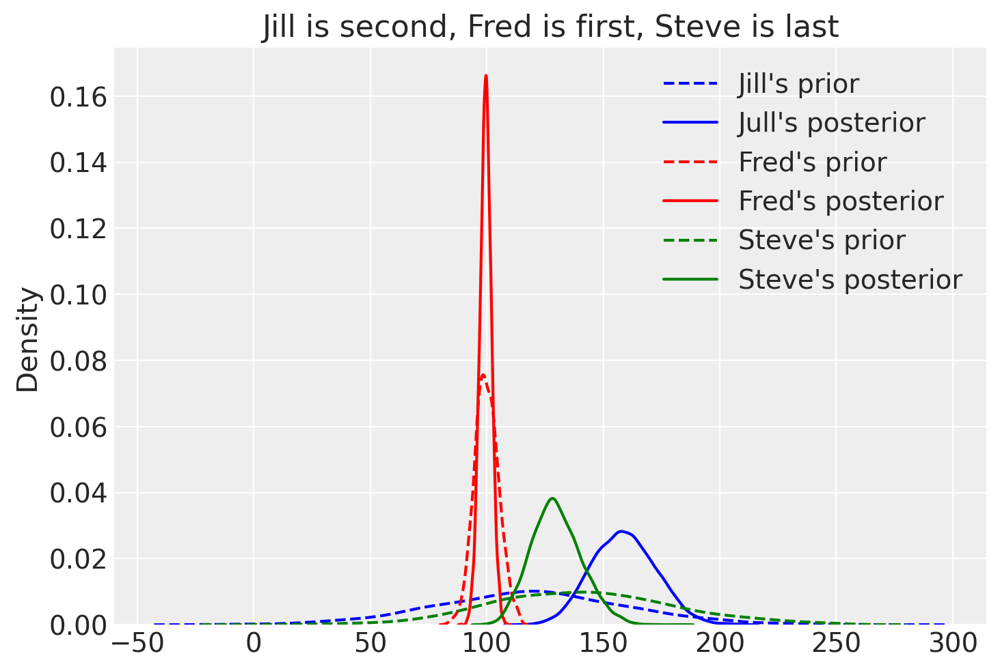

In [147]:
sns.kdeplot(prior_perf['JSkill'], label="Jill's prior", ls='--', color='blue')
sns.kdeplot(pd.Series(idata.posterior['JSkill'].mean(axis=0)), label="Jull's posterior", color='blue')


sns.kdeplot(prior_perf['FSkill'], label="Fred's prior", ls='--', color='red')
sns.kdeplot(pd.Series(idata.posterior['FSkill'].mean(axis=0)), label="Fred's posterior", color='red')

sns.kdeplot(prior_perf['SSkill'], label="Steve's prior", ls='--', color='green')
sns.kdeplot(pd.Series(idata.posterior['SSkill'].mean(axis=0)), label="Steve's posterior", color='green')



_ = plt.legend()
_ = plt.title('Jill is second, Fred is first, Steve is last')

Steve's posterior did not move, I give up on the pymc.Simulator